In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler



## Cluster Test

In [2]:
data = pd.read_csv('../DataOut/bus_trip_all_points_with_acceleration_and_radial_acceleration_and_distance_and_accDiff.csv')

In [3]:
datain_one_direction=data[data['direction']==1]
data_to_cluster=datain_one_direction[['trip_id','deviceid','speed','acceleration','radial_acceleration','acceleration_der']]

In [4]:

# from sklearn.preprocessing import LabelEncoder

# # Initialize the LabelEncoder
# label_encoder = LabelEncoder()

# # Fit and transform the 'bus_stop' column
# data_to_cluster['bus_stop'] = label_encoder.fit_transform(data_to_cluster['bus_stop'])

# # Display the encoded DataFrame
# print(data_to_cluster)


In [5]:
data_to_cluster

,trip_id,deviceid,speed,acceleration,radial_acceleration,acceleration_der
0,2.0,116,10.25920,-0.251980,1.278067,-0.038397
1,2.0,116,7.55940,-0.179987,0.722300,0.004800
2,2.0,116,3.77970,-0.251980,0.048332,-0.004800
3,2.0,116,9.17927,0.359971,1.052222,0.040797
4,2.0,116,8.63931,-0.035997,0.639311,-0.026398
...,...,...,...,...,...,...
624811,5587.0,262,2.15983,-0.057853,0.017268,-0.014922
624812,5587.0,262,2.15983,0.000000,0.050073,0.001653
624813,5587.0,262,2.69978,0.539950,0.056444,0.539950
624814,5587.0,262,5.39957,0.674947,0.062833,0.033749


In [6]:
# group by device_id by getting the mean value of speed
# data_to_cluster_mean=data_to_cluster.groupby('deviceid')['speed'].mean().reset_index()

# reset index
data_to_cluster=data_to_cluster.reset_index(drop=True)

features_only_df = data_to_cluster[['speed', 'acceleration', 'radial_acceleration','acceleration_der']]


In [7]:
features_only_df

,speed,acceleration,radial_acceleration,acceleration_der
0,10.25920,-0.251980,1.278067,-0.038397
1,7.55940,-0.179987,0.722300,0.004800
2,3.77970,-0.251980,0.048332,-0.004800
3,9.17927,0.359971,1.052222,0.040797
4,8.63931,-0.035997,0.639311,-0.026398
...,...,...,...,...
624811,2.15983,-0.057853,0.017268,-0.014922
624812,2.15983,0.000000,0.050073,0.001653
624813,2.69978,0.539950,0.056444,0.539950
624814,5.39957,0.674947,0.062833,0.033749


In [8]:
# print all the column names
print(features_only_df.columns)

Index(['speed', 'acceleration', 'radial_acceleration', 'acceleration_der'], dtype='object')


In [9]:
# from sklearn.cluster import KMeans
# import matplotlib.pyplot as plt

# # Assuming you have your preprocessed data in 'data_to_cluster_mean'

# # List to store distortion values
# distortions = []

# # Choose a range of cluster counts to try
# cluster_range = range(1, 11)

# # Calculate distortion for each cluster count
# for num_clusters in cluster_range:
#     kmeans = KMeans(n_clusters=num_clusters, random_state=0)
#     kmeans.fit(data_to_cluster_mean)
#     distortions.append(kmeans.inertia_)  # Inertia is the sum of squared distances to the nearest cluster center

# # Plot the elbow curve
# plt.plot(cluster_range, distortions, marker='o')
# plt.xlabel('Number of Clusters')
# plt.ylabel('Distortion')
# plt.title('Elbow Method')
# plt.show()


In [10]:
# get the number of Nan values in each column
print(features_only_df.isna().sum())

speed                  0
acceleration           0
radial_acceleration    0
acceleration_der       0
dtype: int64


c:\Python311\Lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


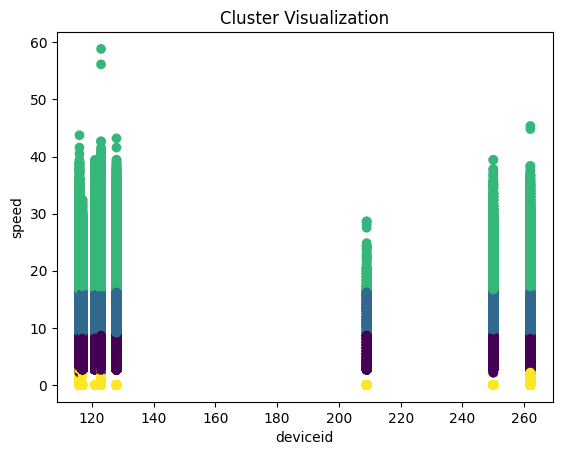

In [11]:
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt

# Choose the number of clusters
num_clusters = 4

# Initialize the clustering algorithm
kmeans = KMeans(n_clusters=num_clusters, random_state=0)

# Fit the algorithm to your data
kmeans.fit(features_only_df)

# Get cluster assignments for each data point
cluster_labels = kmeans.labels_

# Get cluster centers (centroids)
cluster_centers = kmeans.cluster_centers_

# Add cluster labels to your original dataset
data_with_clusters = pd.DataFrame(features_only_df, columns=['speed', 'acceleration', 'radial_acceleration','acceleration_der'])
data_with_clusters['cluster'] = cluster_labels
data_with_clusters['deviceid'] = data_to_cluster['deviceid']  # Add 'deviceid' column from data_to_cluster
data_with_clusters['trip_id'] = data_to_cluster['trip_id']  

# Visualize the clusters (for 2D data)
plt.scatter(data_with_clusters['deviceid'], data_with_clusters['speed'], c=cluster_labels, cmap='viridis')
plt.xlabel('deviceid')
plt.ylabel('speed')
plt.title('Cluster Visualization')
plt.show()


In [12]:
def draw_clusters(data_with_clusters,x_axis,y_axis):
    # Visualize the clusters (for 2D data)
    plt.scatter(data_with_clusters[x_axis], data_with_clusters[y_axis], c=cluster_labels, cmap='viridis')
    plt.scatter(cluster_centers[:, 0], cluster_centers[:, 1], marker='X', s=100, c='red')
    plt.xlabel(x_axis)
    plt.ylabel(y_axis)
    plt.title('Cluster Visualization')
    plt.show()


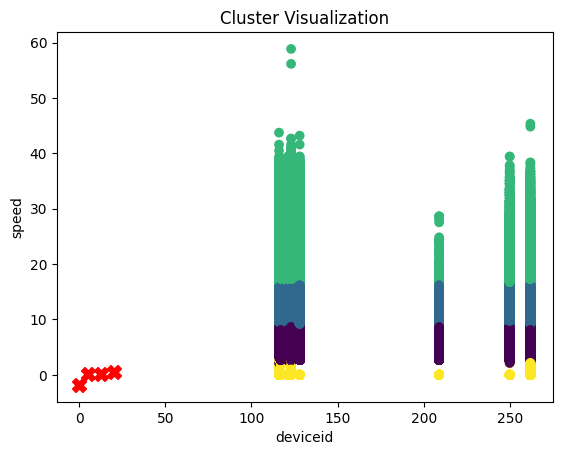

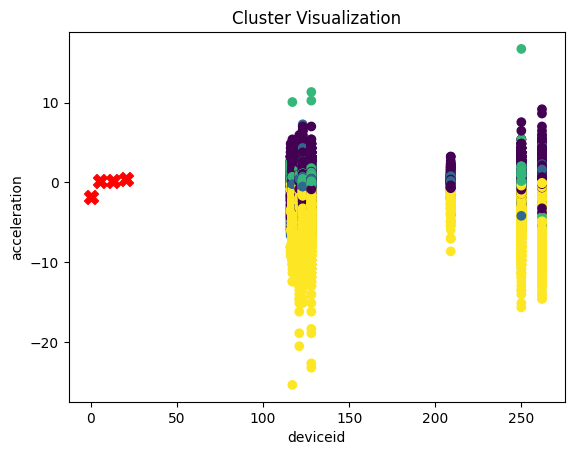

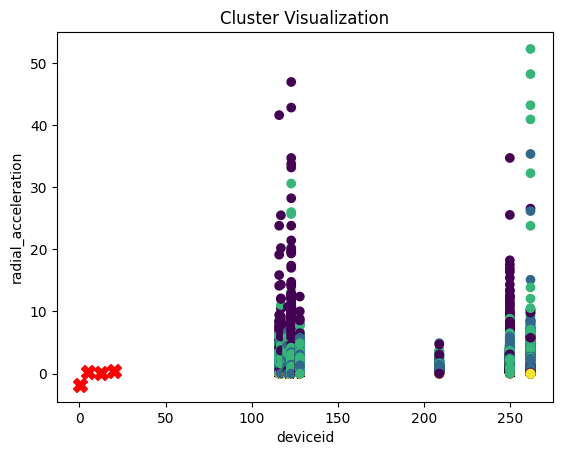

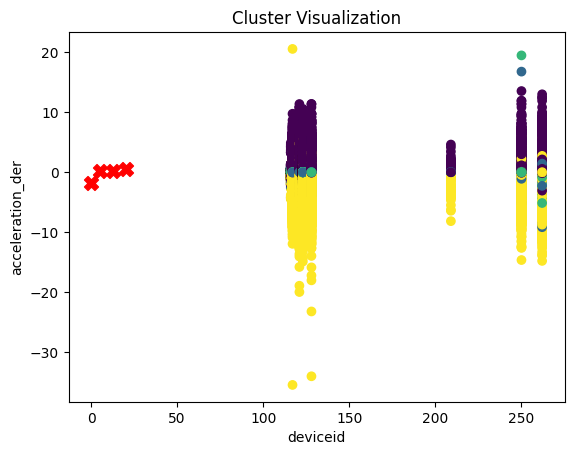

In [13]:
draw_clusters(data_with_clusters,'deviceid','speed')
draw_clusters(data_with_clusters,'deviceid','acceleration')
draw_clusters(data_with_clusters,'deviceid','radial_acceleration')
draw_clusters(data_with_clusters,'deviceid','acceleration_der')

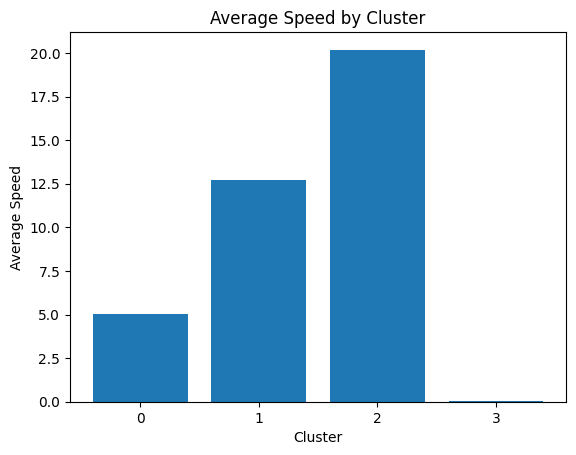

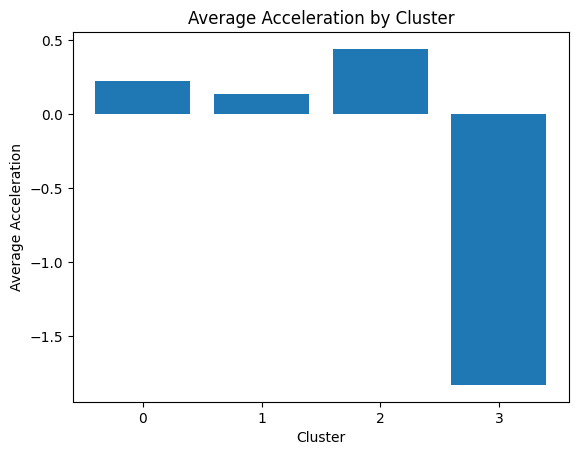

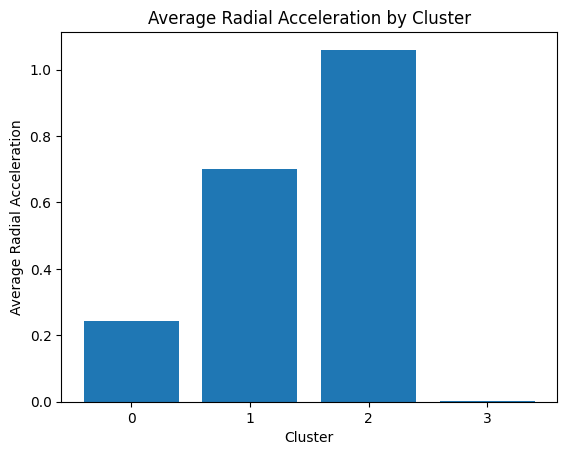

In [14]:
import matplotlib.pyplot as plt

# Calculate average values for each cluster
average_values = data_with_clusters.groupby('cluster').mean()

# Plot bar graph for Average Speed
plt.bar(average_values.index, average_values['speed'])
plt.xlabel('Cluster')
plt.ylabel('Average Speed')
plt.title('Average Speed by Cluster')
plt.xticks(average_values.index)
plt.show()

# Plot bar graph for Average Acceleration
plt.bar(average_values.index, average_values['acceleration'])
plt.xlabel('Cluster')
plt.ylabel('Average Acceleration')
plt.title('Average Acceleration by Cluster')
plt.xticks(average_values.index)
plt.show()

# Plot bar graph for Average Radial Acceleration
plt.bar(average_values.index, average_values['radial_acceleration'])
plt.xlabel('Cluster')
plt.ylabel('Average Radial Acceleration')
plt.title('Average Radial Acceleration by Cluster')
plt.xticks(average_values.index)
plt.show()


In [15]:
# create a dataframe group by device id and taking the mode of cluster column in data_with_clusters dataframe
cluster_df=data_with_clusters.groupby('deviceid')['cluster'].agg(pd.Series.mode).reset_index()

In [16]:
data_with_clusters

,speed,acceleration,radial_acceleration,acceleration_der,cluster,deviceid,trip_id
0,10.25920,-0.251980,1.278067,-0.038397,1,116,2.0
1,7.55940,-0.179987,0.722300,0.004800,0,116,2.0
2,3.77970,-0.251980,0.048332,-0.004800,0,116,2.0
3,9.17927,0.359971,1.052222,0.040797,1,116,2.0
4,8.63931,-0.035997,0.639311,-0.026398,0,116,2.0
...,...,...,...,...,...,...,...
624811,2.15983,-0.057853,0.017268,-0.014922,3,262,5587.0
624812,2.15983,0.000000,0.050073,0.001653,3,262,5587.0
624813,2.69978,0.539950,0.056444,0.539950,0,262,5587.0
624814,5.39957,0.674947,0.062833,0.033749,0,262,5587.0


In [17]:
cluster_df


,deviceid,cluster
0,116,1
1,117,0
2,121,0
3,123,0
4,128,0
5,209,0
6,250,0
7,262,0


In [18]:
data

,id,deviceid,devicetime,latitude,longitude,speed,date,time,geometry,bus_stop,trip_id,direction,acceleration,radial_acceleration,distance_from_start,time_diff,acc_diff,acceleration_der
0,574733100,116,2021-10-16 08:03:34,7.293043,80.637552,10.25920,2021-10-16,08:03:34,POINT (184964.84865244984 232317.35306792473),NaN,2.0,1,-0.251980,1.278067,123.738485,0 days 00:00:15,-0.575955,-0.038397
1,574733101,116,2021-10-16 08:03:49,7.292725,80.637707,7.55940,2021-10-16,08:03:49,POINT (184981.95255171193 232282.14959255166),NaN,2.0,1,-0.179987,0.722300,163.044397,0 days 00:00:15,0.071993,0.004800
2,574733102,116,2021-10-16 08:04:04,7.292292,80.637663,3.77970,2021-10-16,08:04:04,POINT (184977.15733984314 232234.22458233108),NaN,2.0,1,-0.251980,0.048332,211.472339,0 days 00:00:15,-0.071993,-0.004800
3,574736662,116,2021-10-16 08:04:19,7.291640,80.637455,9.17927,2021-10-16,08:04:19,POINT (184954.1363920236 232162.16484193364),101,2.0,1,0.359971,1.052222,287.492821,0 days 00:00:15,0.611951,0.040797
4,574736663,116,2021-10-16 08:04:34,7.291210,80.637713,8.63931,2021-10-16,08:04:34,POINT (184982.64260533327 232114.61697960715),101,2.0,1,-0.035997,0.639311,343.141212,0 days 00:00:15,-0.395969,-0.026398
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1243130,1310926397,262,2022-08-09 10:55:05,7.290370,80.638812,20.51840,2022-08-09,10:55:05,POINT (185103.88471817068 232021.69189563429),NaN,5586.0,2,-0.539900,4.312238,16062.472333,0 days 00:00:01,-0.694171,-0.694171
1243131,1310926396,262,2022-08-09 10:55:37,7.291380,80.637410,7.55940,2022-08-09,10:55:37,POINT (184949.15914480377 232133.4259444512),NaN,5586.0,2,-0.404969,0.096588,16253.551165,0 days 00:00:32,0.134931,0.004217
1243132,1310926395,262,2022-08-09 10:55:38,7.291392,80.637387,7.55940,2022-08-09,10:55:38,POINT (184946.57580228115 232134.70946937904),NaN,5586.0,2,0.000000,0.588683,16256.436454,0 days 00:00:01,0.404969,0.404969
1243133,1310926393,262,2022-08-09 10:55:53,7.291295,80.636463,12.95900,2022-08-09,10:55:53,POINT (184844.62591334787 232124.05764201845),NaN,5586.0,2,0.359973,0.563965,16358.837456,0 days 00:00:15,0.359973,0.023998


In [19]:
# in data dataframe, select all the raws within a given date around a 5 minitues time interval around a given time
data['devicetime']=pd.to_datetime(data['devicetime'])

# Given date and time
given_date = '2021-10-16'
given_time = '08:03:04'

# Convert given time to datetime format
given_datetime = pd.to_datetime('2021-10-27 14:50:45')

# Calculate time range for the interval
time_range = pd.to_timedelta('1 minutes')

# Filter rows within the time interval around the given time
selected_rows = data[
    (data['devicetime'] >= (given_datetime - time_range)) &
    (data['devicetime'] <= (given_datetime + time_range))
]




In [20]:
selected_rows

,id,deviceid,devicetime,latitude,longitude,speed,date,time,geometry,bus_stop,trip_id,direction,acceleration,radial_acceleration,distance_from_start,time_diff,acc_diff,acceleration_der


## Time serious cluster test

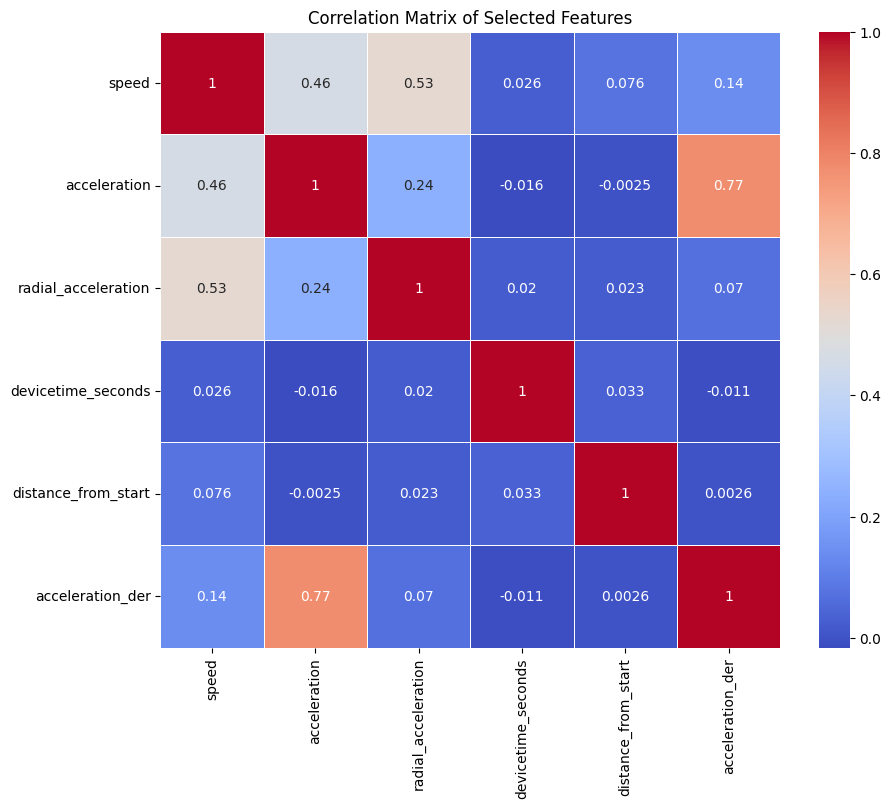

In [21]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Load your dataset (assuming it's named 'data')
# data = pd.read_csv('your_dataset.csv')

# Convert 'devicetime' to pandas Timestamp
data['devicetime'] = pd.to_datetime(data['devicetime'])

# Convert 'devicetime' to seconds
data['devicetime_seconds'] = (data['devicetime'] - data['devicetime'].min()).dt.total_seconds()

# Select the features for correlation matrix
selected_features = ['speed', 'acceleration', 'radial_acceleration', 'devicetime_seconds','distance_from_start','acceleration_der']

# Calculate the correlation matrix
correlation_matrix = data[selected_features].corr()

# Create a heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', linewidths=.5)
plt.title("Correlation Matrix of Selected Features")
plt.show()


In [22]:
from sklearn.preprocessing import StandardScaler

# Create empty lists to store trip IDs and dataframes
processed_trip_ids = []
dataframes_without_trip_id = []

# Iterate through each unique trip_id
for trip_id in datain_one_direction['trip_id'].unique():
    # Filter the data for the current trip_id
    trip_data = datain_one_direction[datain_one_direction['trip_id'] == trip_id].copy()
    
    # Remove the trip_id column from the current trip_data
    trip_data_without_id = trip_data[['devicetime', 'radial_acceleration','speed', 'acceleration','distance_from_start','acceleration_der']]
    
    # Ensure selected columns are numeric (e.g., exclude any object or string columns)
    numeric_columns = [ 'radial_acceleration','speed', 'acceleration','distance_from_start','acceleration_der']
    trip_data_without_id [numeric_columns]= trip_data_without_id[numeric_columns].astype(float)  # Convert to float data type
    
    # # Initialize the StandardScaler
    # scaler = StandardScaler()
    
    # columns_to_scale = ['radial_acceleration']

    # # Fit and transform the selected columns
    # trip_data_without_id[columns_to_scale] = scaler.fit_transform(trip_data_without_id[columns_to_scale])
    

    # Append the trip_id to the list
    processed_trip_ids.append(trip_id)
    
    # Append the dataframe without trip_id to the list
    dataframes_without_trip_id.append(trip_data_without_id)

# Print the processed trip IDs and the first few rows of each dataframe
for trip_id, df in zip(processed_trip_ids, dataframes_without_trip_id):
    print(f"Processed Trip ID: {trip_id}")
    print(df.head())  # Print the first few rows of the dataframe
    print("\n")


C:\Users\gw\AppData\Local\Temp\ipykernel_71348\2356392422.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  trip_data_without_id [numeric_columns]= trip_data_without_id[numeric_columns].astype(float)  # Convert to float data type
C:\Users\gw\AppData\Local\Temp\ipykernel_71348\2356392422.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  trip_data_without_id [numeric_columns]= trip_data_without_id[numeric_columns].astype(float)  # Convert to float data type
C:\Users\gw\AppData\Local\Temp\ipykernel_71348

Processed Trip ID: 2.0
            devicetime  radial_acceleration     speed  acceleration  \
0  2021-10-16 08:03:34             1.278067  10.25920     -0.251980   
1  2021-10-16 08:03:49             0.722300   7.55940     -0.179987   
2  2021-10-16 08:04:04             0.048332   3.77970     -0.251980   
3  2021-10-16 08:04:19             1.052222   9.17927      0.359971   
4  2021-10-16 08:04:34             0.639311   8.63931     -0.035997   

   distance_from_start  acceleration_der  
0           123.738485         -0.038397  
1           163.044397          0.004800  
2           211.472339         -0.004800  
3           287.492821          0.040797  
4           343.141212         -0.026398  


Processed Trip ID: 4.0
              devicetime  radial_acceleration    speed  acceleration  \
205  2021-10-16 12:21:15             0.058599  7.01944      0.467963   
206  2021-10-16 12:21:30             0.092952  9.71923      0.179986   
207  2021-10-16 12:21:45             0.483596  8.63

In [23]:
total_dis=0

for index, df in enumerate(dataframes_without_trip_id):
    current_max = df['distance_from_start'].max()
    total_dis+=current_max
    
avg_dis=total_dis/len(dataframes_without_trip_id)

print("average distance : ", avg_dis)


average distance :  16165.865126620867


In [24]:
print(len(dataframes_without_trip_id))

2736


In [25]:
# Step 1: Identify the maximum distance_from_start value across all dataframes
max_distance = max(df['distance_from_start'].max() for df in dataframes_without_trip_id)
max_distance

82337.0434658419

In [26]:
new_dataframes = []
new_processed_trip_ids = []

for index, df in enumerate(dataframes_without_trip_id):
    distance_of_the_trip = df['distance_from_start'].max()
    if distance_of_the_trip <= (avg_dis + 250):
        # Keep this DataFrame
        new_dataframes.append(df)
        new_processed_trip_ids.append(processed_trip_ids[index])

# Replace the original lists with the filtered lists
dataframes_without_trip_id = new_dataframes
processed_trip_ids = new_processed_trip_ids


In [27]:
# Step 1: Identify the maximum distance_from_start value across all dataframes
max_distance = max(df['distance_from_start'].max() for df in dataframes_without_trip_id)
max_distance

16381.445892990048

In [28]:
print(len(dataframes_without_trip_id))

2640


In [29]:
dataframes_without_trip_id[1]

,devicetime,radial_acceleration,speed,acceleration,distance_from_start,acceleration_der
205,2021-10-16 12:21:15,0.058599,7.01944,0.467963,40.639631,0.057595
206,2021-10-16 12:21:30,0.092952,9.71923,0.179986,110.740656,-0.019198
207,2021-10-16 12:21:45,0.483596,8.63931,-0.071995,193.101564,-0.016799
208,2021-10-16 12:22:00,0.751005,4.85961,-0.251980,236.850009,-0.011999
209,2021-10-16 12:22:15,0.024231,4.31966,-0.035997,271.835124,0.014399
...,...,...,...,...,...,...
436,2021-10-16 13:17:33,0.000000,0.00000,-1.529875,15616.015197,-0.187485
437,2021-10-16 13:17:48,0.405917,8.63931,0.575954,15644.008931,0.140389
438,2021-10-16 13:18:03,0.916469,15.11880,0.431966,15733.065369,-0.009599
439,2021-10-16 13:18:18,1.369753,14.57880,-0.036000,15855.685329,-0.031198


In [30]:
# delete rows with duplicate distance_from_start values in each data frames in dataframes_without_trip_id list
for df in dataframes_without_trip_id:
    df.drop_duplicates(subset=['distance_from_start'], keep='first', inplace=True)

In [31]:
df

,devicetime,radial_acceleration,speed,acceleration,distance_from_start,acceleration_der
624406,2022-08-06 12:16:27,2.512797,5.39957,1.349895,5.881452,0.607453
624407,2022-08-06 12:16:47,0.035418,1.61987,-0.188985,21.920685,-0.076944
624408,2022-08-06 12:16:48,0.088663,3.23974,1.619870,39.545919,1.808855
624409,2022-08-06 12:16:49,0.142277,4.31966,1.079920,54.139268,-0.539950
624410,2022-08-06 12:17:22,0.005041,1.07991,-0.098174,261.714931,-0.035700
624411,2022-08-06 12:17:24,0.179827,3.77970,1.349895,300.288807,0.724035
624412,2022-08-06 12:17:25,0.214232,4.31966,0.539960,304.864817,-0.809935
624413,2022-08-06 12:17:51,0.426888,4.31966,0.000000,391.266253,-0.020768
624414,2022-08-06 12:17:52,0.128446,5.93953,1.619870,410.603176,1.619870
624415,2022-08-06 12:18:01,0.000000,0.00000,-0.659948,445.081289,-0.253313


In [32]:
# Assuming dataframes_without_trip_id is a list of dataframes with 'devicetime' column
for df in dataframes_without_trip_id:
    df['devicetime'] = pd.to_datetime(df['devicetime'])  # Convert to datetime if not already
    
    # Calculate time difference in seconds since trip start
    df['devicetime'] = (df['devicetime'] - df['devicetime'].min()).dt.total_seconds()

    # Print the updated dataframe
    print(df)

     devicetime  radial_acceleration     speed  acceleration  \
0           0.0             1.278067  10.25920     -0.251980   
1          15.0             0.722300   7.55940     -0.179987   
2          30.0             0.048332   3.77970     -0.251980   
3          45.0             1.052222   9.17927      0.359971   
4          60.0             0.639311   8.63931     -0.035997   
..          ...                  ...       ...           ...   
200      2954.0             0.000000   0.00000     -0.791940   
201      2969.0             0.481587   7.55940      0.503960   
202      2984.0             0.155985  15.11880      0.503960   
203      2999.0             1.672843  18.35850      0.215980   
204      3014.0             0.000000   4.85961     -0.899926   

     distance_from_start  acceleration_der  
0             123.738485         -0.038397  
1             163.044397          0.004800  
2             211.472339         -0.004800  
3             287.492821          0.040797  
4     

C:\Users\gw\AppData\Local\Temp\ipykernel_71348\3500269481.py:3: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df['devicetime'] = pd.to_datetime(df['devicetime'])  # Convert to datetime if not already
C:\Users\gw\AppData\Local\Temp\ipykernel_71348\3500269481.py:3: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df['devicetime'] = pd.to_datetime(df['devicetime'])  # Convert to datetime if not already


       devicetime  radial_acceleration     speed  acceleration  \
47420         0.0             0.252247   9.71923      0.143989   
47421        15.0             0.832938  10.25920      0.035998   
47422        30.0             0.661989   4.85961     -0.359973   
47423        45.0             0.014831   5.39957      0.035997   
47424        60.0             0.120779   4.85961     -0.035997   
...           ...                  ...       ...           ...   
47632      3152.0             1.453688  16.73870      0.215987   
47633      3167.0             0.119121  14.57880     -0.143993   
47634      3182.0             1.475288  16.19870      0.107993   
47635      3197.0             1.867197  17.81860      0.107993   
47636      3212.0             0.000000   3.77970     -0.935927   

       distance_from_start  acceleration_der  
47420            71.035377      7.199422e-03  
47421           157.517349     -7.199378e-03  
47422           194.493821     -2.639804e-02  
47423           247

C:\Users\gw\AppData\Local\Temp\ipykernel_71348\3500269481.py:3: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df['devicetime'] = pd.to_datetime(df['devicetime'])  # Convert to datetime if not already


        devicetime  radial_acceleration     speed  acceleration  \
327245         0.0             0.020066   4.85961      0.607451   
327246        15.0             0.082577  10.79910      0.395966   
327247        30.0             0.672363  11.87910      0.072000   
327248        40.0             0.000000   0.00000     -1.187910   
327249        45.0             0.037339   4.31966      0.863932   
...            ...                  ...       ...           ...   
327454      2867.0             0.000000   0.00000     -1.536800   
327455      2879.0             0.053237   2.69978      0.224982   
327456      2894.0             1.153209  10.79910      0.539955   
327457      2909.0             2.755857  21.59830      0.719947   
327458      2924.0             0.000000  12.95900     -0.575953   

        distance_from_start  acceleration_der  
327245             8.638193          0.291914  
327246            90.960427         -0.014099  
327247           184.711654         -0.021598  
327

In [33]:
dataframes_without_trip_id[2].head(20)

,devicetime,radial_acceleration,speed,acceleration,distance_from_start,acceleration_der
441,0.0,0.207373,6.47948,0.431965,22.809853,0.059995
442,15.0,0.097039,5.93953,-0.035997,85.025496,-0.031197
443,30.0,0.014021,8.09935,0.143988,157.635054,0.011999
444,45.0,0.000000,0.00000,-0.539957,203.417153,-0.045596
445,60.0,0.888259,5.39957,0.359971,235.580231,0.059995
446,75.0,0.039453,4.31966,-0.071994,281.142239,-0.028798
447,90.0,0.410817,8.63931,0.287977,352.469453,0.023998
448,105.0,1.506472,9.71923,0.071995,417.108821,-0.014399
449,120.0,0.000000,0.00000,-0.647949,471.350128,-0.047996
450,135.0,0.000000,0.00000,0.000000,471.608731,0.043197


In [34]:
# import bus trips
bus_trips = pd.read_csv("../DataOut/bus_trips.csv")

bus_trips

,trip_id,deviceid,date,start_terminal,end_terminal,direction,start_time,end_time,duration,duration_in_mins,day_of_week,hour_of_day
0,1.0,116,2021-10-16,BT02,BT01,2,07:08:31,07:53:04,0:44:33,44.550000,5,7
1,2.0,116,2021-10-16,BT01,BT02,1,08:03:04,08:53:48,0:50:44,50.733333,5,8
2,3.0,116,2021-10-16,BT02,BT01,2,10:50:19,11:44:43,0:54:24,54.400000,5,10
3,4.0,116,2021-10-16,BT01,BT02,1,12:20:45,13:18:33,0:57:48,57.800000,5,12
4,5.0,116,2021-10-16,BT02,BT01,2,14:14:36,15:07:05,0:52:29,52.483333,5,14
...,...,...,...,...,...,...,...,...,...,...,...,...
15886,15891.0,1719,2022-02-25,BT01,BT02,1,09:42:39,10:34:59,0:52:20,52.333333,4,9
15887,15892.0,1719,2022-02-25,BT02,BT01,2,12:20:33,13:15:43,0:55:10,55.166667,4,12
15888,15893.0,1719,2022-02-25,BT01,BT02,1,13:41:19,14:38:03,0:56:44,56.733333,4,13
15889,15894.0,1719,2022-02-25,BT02,BT01,2,16:00:04,16:48:05,0:48:01,48.016667,4,16


In [35]:
# sort bus_trips dataframe by duration_in_mins , in dessending order
bus_trips.sort_values(by=['duration_in_mins'], ascending=False, inplace=True)

In [36]:
bus_trips.head(40)

,trip_id,deviceid,date,start_terminal,end_terminal,direction,start_time,end_time,duration,duration_in_mins,day_of_week,hour_of_day
6369,6372.0,264,2022-02-26,BT02,BT01,2,05:55:06,23:15:05,17:19:59,1039.983333,5,5
3455,3456.0,123,2022-10-30,BT02,BT01,2,05:01:26,19:30:19,14:28:53,868.883333,6,5
15672,15677.0,1718,2022-01-28,BT01,BT02,1,07:00:04,20:51:27,13:51:23,831.383333,4,7
6421,6424.0,264,2022-09-22,BT02,BT01,2,06:02:32,18:55:13,12:52:41,772.683333,3,6
3786,3787.0,128,2021-12-18,BT02,BT01,2,07:40:45,19:22:33,11:41:48,701.800000,5,7
3310,3311.0,123,2022-09-26,BT01,BT02,1,06:37:56,17:51:22,11:13:26,673.433333,0,6
2121,2122.0,121,2022-08-25,BT01,BT02,1,04:43:41,15:47:08,11:03:27,663.450000,3,4
12215,12220.0,1166,2022-07-02,BT01,BT02,1,05:43:13,16:05:09,10:21:56,621.933333,5,5
12239,12244.0,1166,2022-07-12,BT02,BT01,2,08:24:07,18:15:54,9:51:47,591.783333,1,8
2148,2149.0,121,2022-09-05,BT01,BT02,1,04:38:37,13:53:36,9:14:59,554.983333,0,4


In [37]:
# #### Interpolate Device time #####


# import numpy as np
# import pandas as pd
# from scipy.interpolate import interp1d

# # Assume you have a list of dataframes with 'devicetime' and other features
# dataframes = dataframes_without_trip_id  # List of dataframes

# # Step 1: Identify the maximum time duration across all dataframes
# max_duration = max(df['devicetime'].max() for df in dataframes)

# # Step 2: Define a common time interval (e.g., 15 seconds)
# common_time_interval = 15

# # Create a new dataframe with uniform devicetime values
# new_time_values = np.arange(0, max_duration, common_time_interval)
# new_time_df = pd.DataFrame({'devicetime': new_time_values})

# # Step 3 and 4: Interpolate other features for each dataframe
# interpolated_dataframes = []
# for df in dataframes:
#     # Merge the new_time_df with the current dataframe based on 'devicetime'
#     merged_df = pd.merge(new_time_df, df, on='devicetime', how='left')
    
#     # Interpolate other features using linear interpolation
#     features_to_interpolate = df.columns.difference(['devicetime'])
#     for feature in features_to_interpolate:
#         interpolator = interp1d(merged_df['devicetime'], merged_df[feature], kind='linear', fill_value='extrapolate')
#         merged_df[feature] = interpolator(new_time_values)
#         #fill null values
#         merged_df[feature].fillna(0, inplace=True)
    
#     interpolated_dataframes.append(merged_df)

# # Now, interpolated_dataframes contains dataframes with uniform devicetime and interpolated features


In [38]:
import numpy as np
import pandas as pd
from scipy.interpolate import interp1d

# Assume you have a list of dataframes with 'distance_from_start' and other features
dataframes = dataframes_without_trip_id  # List of dataframes

# Step 1: Identify the maximum distance_from_start value across all dataframes
max_distance = max(df['distance_from_start'].max() for df in dataframes)

# Step 2: Define a common distance interval (e.g., 100 meters)
common_distance_interval = 50

# Create a new dataframe with uniform distance_from_start values
new_distance_values = np.arange(0, max_distance, common_distance_interval)
new_distance_df = pd.DataFrame({'distance_from_start': new_distance_values})

# Step 3 and 4: Interpolate other features for each dataframe
interpolated_dataframes = []
for df in dataframes:
    # Merge the new_distance_df with the current dataframe based on 'distance_from_start'
    merged_df = pd.merge(new_distance_df, df, on='distance_from_start', how='left')
    
    # Interpolate other features using linear interpolation
    features_to_interpolate = df.columns.difference(['distance_from_start'])
    # Loop through the features and interpolate
    for feature in features_to_interpolate:
        interpolator = interp1d(df['distance_from_start'], df[feature], kind='linear', fill_value='extrapolate')
        interpolated_values = interpolator(new_distance_values)
        
        # Create a mask for values beyond the range of the original data
        mask = (new_distance_values < df['distance_from_start'].min()) | (new_distance_values > df['distance_from_start'].max())
        
        # Set values outside the original data range to 0
        interpolated_values[mask] = 0
        
        # Add the interpolated values as a new column to the merged_df
        merged_df[feature] = interpolated_values
        
    merged_df.drop(['devicetime'], axis=1, inplace=True)
    interpolated_dataframes.append(merged_df)

# Now, interpolated_dataframes contains dataframes with uniform distance_from_start and interpolated features


In [39]:
max_distance

16381.445892990048

In [40]:
# processed_trip_ids[1665]

In [41]:
interpolated_dataframes[1]

,distance_from_start,radial_acceleration,speed,acceleration,acceleration_der
0,0.0,0.000000,0.000000,0.000000,0.000000
1,50.0,0.063186,7.379934,0.429510,0.047341
2,100.0,0.087689,9.305577,0.224109,-0.007432
3,150.0,0.279162,9.204460,0.059873,-0.018055
4,200.0,0.525762,8.043311,-0.100376,-0.016042
...,...,...,...,...,...
323,16150.0,0.000000,0.000000,0.000000,0.000000
324,16200.0,0.000000,0.000000,0.000000,0.000000
325,16250.0,0.000000,0.000000,0.000000,0.000000
326,16300.0,0.000000,0.000000,0.000000,0.000000


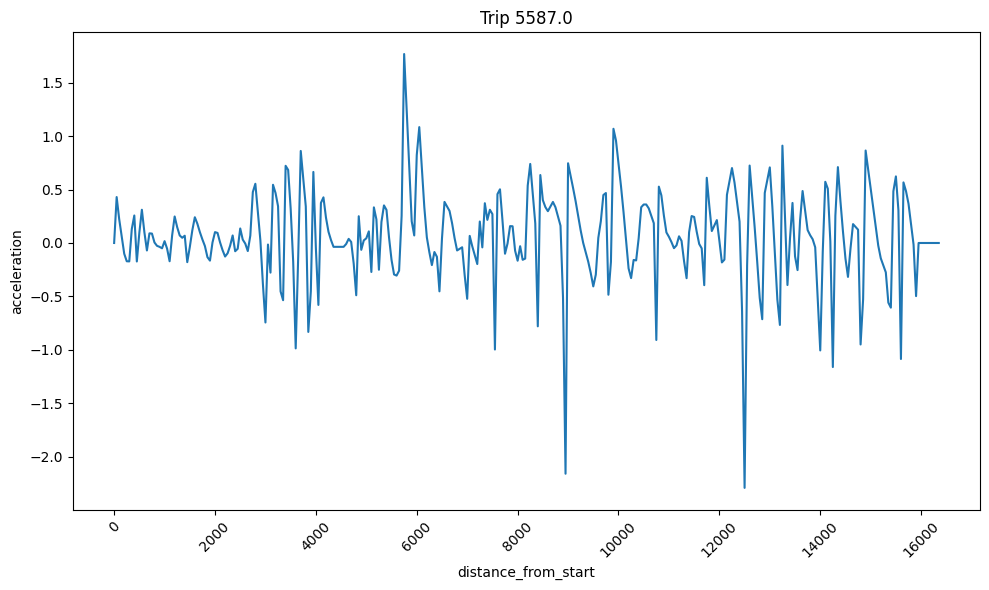

In [42]:
columnx='distance_from_start'
columny='acceleration'

trip_df = interpolated_dataframes[1]
plt.figure(figsize=(10, 6))  # Adjust figure size as needed
plt.plot(trip_df[f"{columnx}"], trip_df[f"{columny}"])
plt.xlabel(f"{columnx}")
plt.ylabel(f"{columny}")
plt.title("Trip " + str(trip_id))
plt.xticks(rotation=45)  # Rotate x-axis labels for better visibility
plt.tight_layout()  # Adjust layout for better formatting
plt.show()

In [43]:
interpolated_dataframes[23]

,distance_from_start,radial_acceleration,speed,acceleration,acceleration_der
0,0.0,0.000000,0.000000,0.000000,0.000000
1,50.0,0.030014,5.661390,0.290152,0.020797
2,100.0,0.051443,6.444581,0.081300,-0.017492
3,150.0,0.699868,7.949785,0.130806,-0.004822
4,200.0,1.160907,9.179270,0.148199,0.003809
...,...,...,...,...,...
323,16150.0,0.000000,0.000000,0.000000,0.000000
324,16200.0,0.000000,0.000000,0.000000,0.000000
325,16250.0,0.000000,0.000000,0.000000,0.000000
326,16300.0,0.000000,0.000000,0.000000,0.000000


In [44]:
len(interpolated_dataframes[1])

328

In [45]:
# get the number of columns in dataframes_without_trip_id
num_columns = len(interpolated_dataframes[0].columns)
num_columns

5

In [46]:
# get a list of column names in interpolated_dataframes
column_namesInter = interpolated_dataframes[1].columns
#make it to a string list of names 
column_namesInter = column_namesInter.tolist()
column_namesInter

['distance_from_start',
 'radial_acceleration',
 'speed',
 'acceleration',
 'acceleration_der']

In [47]:
interpolated_dataframes[1]

,distance_from_start,radial_acceleration,speed,acceleration,acceleration_der
0,0.0,0.000000,0.000000,0.000000,0.000000
1,50.0,0.063186,7.379934,0.429510,0.047341
2,100.0,0.087689,9.305577,0.224109,-0.007432
3,150.0,0.279162,9.204460,0.059873,-0.018055
4,200.0,0.525762,8.043311,-0.100376,-0.016042
...,...,...,...,...,...
323,16150.0,0.000000,0.000000,0.000000,0.000000
324,16200.0,0.000000,0.000000,0.000000,0.000000
325,16250.0,0.000000,0.000000,0.000000,0.000000
326,16300.0,0.000000,0.000000,0.000000,0.000000


In [48]:
# pip install h5py

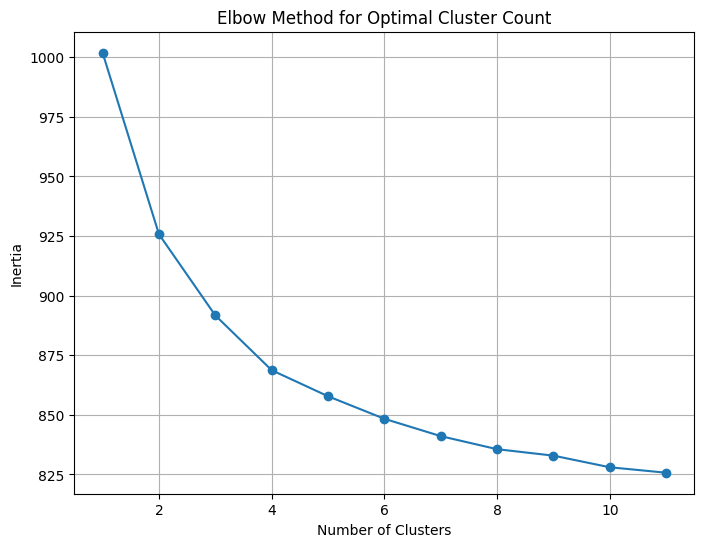

In [49]:
import numpy as np
import matplotlib.pyplot as plt
from tslearn.clustering import TimeSeriesKMeans
from tslearn.preprocessing import TimeSeriesScalerMeanVariance, TimeSeriesResampler

# Convert your list of dataframes to a 3D numpy array
n_ts = len(interpolated_dataframes)
sz = interpolated_dataframes[0].shape[0]
d = interpolated_dataframes[0].shape[1]
data_3d = np.array([df.values for df in interpolated_dataframes])

# Perform preprocessing on the data
X_train = TimeSeriesScalerMeanVariance().fit_transform(data_3d)
X_train = TimeSeriesResampler(sz=sz).fit_transform(X_train)
sz = X_train.shape[1]

# Initialize lists to store inertia values for different cluster counts
inertia_values = []

# Define a range of cluster counts to test
cluster_range = range(1, 12)  # You can adjust the range as needed
seed = 1234
# Calculate inertia for different cluster counts
for cluster_count in cluster_range:
    km = TimeSeriesKMeans(n_clusters=cluster_count,
                          n_init=4,
                          verbose=False,
                          max_iter_barycenter=24,
                          random_state=seed,
                          n_jobs=-1)
    km.fit(X_train)
    inertia_values.append(km.inertia_)

# Plot the elbow graph
plt.figure(figsize=(8, 6))
plt.plot(cluster_range, inertia_values, marker='o', linestyle='-')
plt.title('Elbow Method for Optimal Cluster Count')
plt.xlabel('Number of Clusters')
plt.ylabel('Inertia')
plt.grid(True)
plt.show()


In [89]:
import numpy as np
import matplotlib.pyplot as plt
from tslearn.clustering import TimeSeriesKMeans
from tslearn.preprocessing import TimeSeriesScalerMeanVariance, TimeSeriesResampler

# Convert your list of dataframes to a 3D numpy array
n_ts = len(interpolated_dataframes)
sz = interpolated_dataframes[0].shape[0]
d = interpolated_dataframes[0].shape[1]
data_3d = np.array([df.values for df in interpolated_dataframes])

# Perform preprocessing on the data
X_train = TimeSeriesScalerMeanVariance().fit_transform(data_3d)
X_train = TimeSeriesResampler(sz=sz).fit_transform(X_train)
sz = X_train.shape[1]

# Perform TimeSeriesKMeans clustering
cluster_count = 4
seed = 1234
km = TimeSeriesKMeans(n_clusters=cluster_count,
                          n_init=4,
                        #   metric="dtw",
                          verbose=True,
                          max_iter_barycenter=24,
                          random_state=seed,
                          n_jobs=-1)
y_pred = km.fit_predict(X_train)



Init 1


[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 16 concurrent workers.
[Parallel(n_jobs=-1)]: Done  18 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-1)]: Done 168 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-1)]: Done 418 tasks      | elapsed:    1.5s
[Parallel(n_jobs=-1)]: Done 768 tasks      | elapsed:    1.6s
[Parallel(n_jobs=-1)]: Done 1218 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 1768 tasks      | elapsed:    1.9s
[Parallel(n_jobs=-1)]: Done 2418 tasks      | elapsed:    2.1s
[Parallel(n_jobs=-1)]: Done 2640 out of 2640 | elapsed:    2.2s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 16 concurrent workers.
[Parallel(n_jobs=-1)]: Done  18 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 168 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 418 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 768 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 1218 tasks      | elapsed:    0.2s
[Parallel(n_job

964.039 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 16 concurrent workers.
[Parallel(n_jobs=-1)]: Done  18 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 168 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 418 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 768 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 1218 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 1768 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 2418 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 3168 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 4018 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 4968 tasks      | elapsed:    1.0s
[Parallel(n_jobs=-1)]: Done 6018 tasks      | elapsed:    1.2s
[Parallel(n_jobs=-1)]: Done 7168 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-1)]: Done 8418 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 9768 tasks      | elapsed:    2.0s
[Parallel(n_jobs=-1)]: Done 10560 out of

598.536 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 16 concurrent workers.
[Parallel(n_jobs=-1)]: Done  18 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 168 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 418 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 768 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 1218 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 1768 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 2418 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 3168 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 4018 tasks      | elapsed:    1.0s
[Parallel(n_jobs=-1)]: Done 4968 tasks      | elapsed:    1.3s
[Parallel(n_jobs=-1)]: Done 6018 tasks      | elapsed:    1.6s
[Parallel(n_jobs=-1)]: Done 7168 tasks      | elapsed:    1.9s
[Parallel(n_jobs=-1)]: Done 8418 tasks      | elapsed:    2.2s
[Parallel(n_jobs=-1)]: Done 9768 tasks      | elapsed:    2.6s
[Parallel(n_jobs=-1)]: Done 10560 out of

593.941 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 16 concurrent workers.
[Parallel(n_jobs=-1)]: Done  18 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 168 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 418 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 768 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 1218 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 1768 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 2418 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 3168 tasks      | elapsed:    0.7s
[Parallel(n_jobs=-1)]: Done 4018 tasks      | elapsed:    1.0s
[Parallel(n_jobs=-1)]: Done 4968 tasks      | elapsed:    1.2s
[Parallel(n_jobs=-1)]: Done 6018 tasks      | elapsed:    1.5s
[Parallel(n_jobs=-1)]: Done 7168 tasks      | elapsed:    1.8s
[Parallel(n_jobs=-1)]: Done 8418 tasks      | elapsed:    2.1s
[Parallel(n_jobs=-1)]: Done 9768 tasks      | elapsed:    2.4s
[Parallel(n_jobs=-1)]: Done 10560 out of

592.479 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 16 concurrent workers.
[Parallel(n_jobs=-1)]: Done  18 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 168 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 418 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 768 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 1218 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 1768 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 2418 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done 3168 tasks      | elapsed:    0.7s
[Parallel(n_jobs=-1)]: Done 4018 tasks      | elapsed:    0.9s
[Parallel(n_jobs=-1)]: Done 4968 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done 6018 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-1)]: Done 7168 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 8418 tasks      | elapsed:    2.0s
[Parallel(n_jobs=-1)]: Done 9768 tasks      | elapsed:    2.3s
[Parallel(n_jobs=-1)]: Done 10560 out of

591.832 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 16 concurrent workers.
[Parallel(n_jobs=-1)]: Done  18 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 168 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 418 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 768 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 1218 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 1768 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 2418 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 3168 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 4018 tasks      | elapsed:    1.0s
[Parallel(n_jobs=-1)]: Done 4968 tasks      | elapsed:    1.2s
[Parallel(n_jobs=-1)]: Done 6018 tasks      | elapsed:    1.5s
[Parallel(n_jobs=-1)]: Done 7168 tasks      | elapsed:    1.9s
[Parallel(n_jobs=-1)]: Done 8418 tasks      | elapsed:    2.2s
[Parallel(n_jobs=-1)]: Done 9768 tasks      | elapsed:    2.6s
[Parallel(n_jobs=-1)]: Done 10560 out of

591.421 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 16 concurrent workers.
[Parallel(n_jobs=-1)]: Done  18 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 168 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 418 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 768 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 1218 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 1768 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 2418 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done 3168 tasks      | elapsed:    0.7s
[Parallel(n_jobs=-1)]: Done 4018 tasks      | elapsed:    0.9s
[Parallel(n_jobs=-1)]: Done 4968 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done 6018 tasks      | elapsed:    1.3s
[Parallel(n_jobs=-1)]: Done 7168 tasks      | elapsed:    1.6s
[Parallel(n_jobs=-1)]: Done 8418 tasks      | elapsed:    1.9s
[Parallel(n_jobs=-1)]: Done 9768 tasks      | elapsed:    2.2s
[Parallel(n_jobs=-1)]: Done 10560 out of

591.018 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 16 concurrent workers.
[Parallel(n_jobs=-1)]: Done  18 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 168 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 418 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 768 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 1218 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 1768 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 2418 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 3168 tasks      | elapsed:    0.9s
[Parallel(n_jobs=-1)]: Done 4018 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done 4968 tasks      | elapsed:    1.3s
[Parallel(n_jobs=-1)]: Done 6018 tasks      | elapsed:    1.6s
[Parallel(n_jobs=-1)]: Done 7168 tasks      | elapsed:    1.9s
[Parallel(n_jobs=-1)]: Done 8418 tasks      | elapsed:    2.2s
[Parallel(n_jobs=-1)]: Done 9768 tasks      | elapsed:    2.6s
[Parallel(n_jobs=-1)]: Done 10560 out of

590.763 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 16 concurrent workers.
[Parallel(n_jobs=-1)]: Done  18 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 168 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 418 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 768 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 1218 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 1768 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 2418 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 3168 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 4018 tasks      | elapsed:    1.0s
[Parallel(n_jobs=-1)]: Done 4968 tasks      | elapsed:    1.3s
[Parallel(n_jobs=-1)]: Done 6018 tasks      | elapsed:    1.5s
[Parallel(n_jobs=-1)]: Done 7168 tasks      | elapsed:    1.9s
[Parallel(n_jobs=-1)]: Done 8418 tasks      | elapsed:    2.3s
[Parallel(n_jobs=-1)]: Done 9768 tasks      | elapsed:    2.7s
[Parallel(n_jobs=-1)]: Done 10560 out of

590.429 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 16 concurrent workers.
[Parallel(n_jobs=-1)]: Done  18 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 168 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 418 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 768 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 1218 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 1768 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 2418 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 3168 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 4018 tasks      | elapsed:    0.9s
[Parallel(n_jobs=-1)]: Done 4968 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done 6018 tasks      | elapsed:    1.3s
[Parallel(n_jobs=-1)]: Done 7168 tasks      | elapsed:    1.6s
[Parallel(n_jobs=-1)]: Done 8418 tasks      | elapsed:    2.0s
[Parallel(n_jobs=-1)]: Done 9768 tasks      | elapsed:    2.4s
[Parallel(n_jobs=-1)]: Done 10560 out of

589.930 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 16 concurrent workers.
[Parallel(n_jobs=-1)]: Done  18 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 168 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 418 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 768 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 1218 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 1768 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done 2418 tasks      | elapsed:    0.7s
[Parallel(n_jobs=-1)]: Done 3168 tasks      | elapsed:    0.9s
[Parallel(n_jobs=-1)]: Done 4018 tasks      | elapsed:    1.2s
[Parallel(n_jobs=-1)]: Done 4968 tasks      | elapsed:    1.5s
[Parallel(n_jobs=-1)]: Done 6018 tasks      | elapsed:    1.8s
[Parallel(n_jobs=-1)]: Done 7168 tasks      | elapsed:    2.1s
[Parallel(n_jobs=-1)]: Done 8418 tasks      | elapsed:    2.5s
[Parallel(n_jobs=-1)]: Done 9768 tasks      | elapsed:    3.0s
[Parallel(n_jobs=-1)]: Done 10560 out of

589.244 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 16 concurrent workers.
[Parallel(n_jobs=-1)]: Done  18 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 168 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 418 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 768 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 1218 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 1768 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 2418 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 3168 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 4018 tasks      | elapsed:    1.0s
[Parallel(n_jobs=-1)]: Done 4968 tasks      | elapsed:    1.3s
[Parallel(n_jobs=-1)]: Done 6018 tasks      | elapsed:    1.5s
[Parallel(n_jobs=-1)]: Done 7168 tasks      | elapsed:    1.8s
[Parallel(n_jobs=-1)]: Done 8418 tasks      | elapsed:    2.1s
[Parallel(n_jobs=-1)]: Done 9768 tasks      | elapsed:    2.5s
[Parallel(n_jobs=-1)]: Done 10560 out of

588.783 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 16 concurrent workers.
[Parallel(n_jobs=-1)]: Done  18 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 168 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 418 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 768 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 1218 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 1768 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 2418 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 3168 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 4018 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done 4968 tasks      | elapsed:    1.3s
[Parallel(n_jobs=-1)]: Done 6018 tasks      | elapsed:    1.6s
[Parallel(n_jobs=-1)]: Done 7168 tasks      | elapsed:    1.9s
[Parallel(n_jobs=-1)]: Done 8418 tasks      | elapsed:    2.2s
[Parallel(n_jobs=-1)]: Done 9768 tasks      | elapsed:    2.5s
[Parallel(n_jobs=-1)]: Done 10560 out of

588.459 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 16 concurrent workers.
[Parallel(n_jobs=-1)]: Done  18 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 168 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 418 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 768 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 1218 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 1768 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 2418 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done 3168 tasks      | elapsed:    0.7s
[Parallel(n_jobs=-1)]: Done 4018 tasks      | elapsed:    1.0s
[Parallel(n_jobs=-1)]: Done 4968 tasks      | elapsed:    1.2s
[Parallel(n_jobs=-1)]: Done 6018 tasks      | elapsed:    1.5s
[Parallel(n_jobs=-1)]: Done 7168 tasks      | elapsed:    1.9s
[Parallel(n_jobs=-1)]: Done 8418 tasks      | elapsed:    2.3s
[Parallel(n_jobs=-1)]: Done 9768 tasks      | elapsed:    2.6s
[Parallel(n_jobs=-1)]: Done 10560 out of

588.209 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 16 concurrent workers.
[Parallel(n_jobs=-1)]: Done  18 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 168 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 418 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 768 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 1218 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 1768 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 2418 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done 3168 tasks      | elapsed:    0.7s
[Parallel(n_jobs=-1)]: Done 4018 tasks      | elapsed:    0.9s
[Parallel(n_jobs=-1)]: Done 4968 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done 6018 tasks      | elapsed:    1.3s
[Parallel(n_jobs=-1)]: Done 7168 tasks      | elapsed:    1.6s
[Parallel(n_jobs=-1)]: Done 8418 tasks      | elapsed:    1.9s
[Parallel(n_jobs=-1)]: Done 9768 tasks      | elapsed:    2.2s
[Parallel(n_jobs=-1)]: Done 10560 out of

587.963 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 16 concurrent workers.
[Parallel(n_jobs=-1)]: Done  18 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 168 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 418 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 768 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 1218 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 1768 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 2418 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 3168 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 4018 tasks      | elapsed:    1.0s
[Parallel(n_jobs=-1)]: Done 4968 tasks      | elapsed:    1.3s
[Parallel(n_jobs=-1)]: Done 6018 tasks      | elapsed:    1.5s
[Parallel(n_jobs=-1)]: Done 7168 tasks      | elapsed:    1.8s
[Parallel(n_jobs=-1)]: Done 8418 tasks      | elapsed:    2.1s
[Parallel(n_jobs=-1)]: Done 9768 tasks      | elapsed:    2.4s
[Parallel(n_jobs=-1)]: Done 10560 out of

587.723 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 16 concurrent workers.
[Parallel(n_jobs=-1)]: Done  18 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 168 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 418 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 768 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 1218 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 1768 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done 2418 tasks      | elapsed:    0.7s
[Parallel(n_jobs=-1)]: Done 3168 tasks      | elapsed:    0.9s
[Parallel(n_jobs=-1)]: Done 4018 tasks      | elapsed:    1.2s
[Parallel(n_jobs=-1)]: Done 4968 tasks      | elapsed:    1.5s
[Parallel(n_jobs=-1)]: Done 6018 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 7168 tasks      | elapsed:    2.1s
[Parallel(n_jobs=-1)]: Done 8418 tasks      | elapsed:    2.4s
[Parallel(n_jobs=-1)]: Done 9768 tasks      | elapsed:    2.8s
[Parallel(n_jobs=-1)]: Done 10560 out of

587.458 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 16 concurrent workers.
[Parallel(n_jobs=-1)]: Done  18 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 168 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 418 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 768 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 1218 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 1768 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done 2418 tasks      | elapsed:    0.7s
[Parallel(n_jobs=-1)]: Done 3168 tasks      | elapsed:    0.9s
[Parallel(n_jobs=-1)]: Done 4018 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done 4968 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-1)]: Done 6018 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 7168 tasks      | elapsed:    2.0s
[Parallel(n_jobs=-1)]: Done 8418 tasks      | elapsed:    2.3s
[Parallel(n_jobs=-1)]: Done 9768 tasks      | elapsed:    2.6s
[Parallel(n_jobs=-1)]: Done 10560 out of

587.193 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 16 concurrent workers.
[Parallel(n_jobs=-1)]: Done  18 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 168 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 418 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 768 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 1218 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 1768 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 2418 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done 3168 tasks      | elapsed:    0.7s
[Parallel(n_jobs=-1)]: Done 4018 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 4968 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done 6018 tasks      | elapsed:    1.3s
[Parallel(n_jobs=-1)]: Done 7168 tasks      | elapsed:    1.5s
[Parallel(n_jobs=-1)]: Done 8418 tasks      | elapsed:    1.8s
[Parallel(n_jobs=-1)]: Done 9768 tasks      | elapsed:    2.2s
[Parallel(n_jobs=-1)]: Done 10560 out of

586.917 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 16 concurrent workers.
[Parallel(n_jobs=-1)]: Done  18 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 168 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 418 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 768 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 1218 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 1768 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 2418 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 3168 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 4018 tasks      | elapsed:    1.0s
[Parallel(n_jobs=-1)]: Done 4968 tasks      | elapsed:    1.2s
[Parallel(n_jobs=-1)]: Done 6018 tasks      | elapsed:    1.5s
[Parallel(n_jobs=-1)]: Done 7168 tasks      | elapsed:    1.9s
[Parallel(n_jobs=-1)]: Done 8418 tasks      | elapsed:    2.2s
[Parallel(n_jobs=-1)]: Done 9768 tasks      | elapsed:    2.6s
[Parallel(n_jobs=-1)]: Done 10560 out of

586.647 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 16 concurrent workers.
[Parallel(n_jobs=-1)]: Done  18 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 168 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 418 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 768 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 1218 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 1768 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 2418 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done 3168 tasks      | elapsed:    0.7s
[Parallel(n_jobs=-1)]: Done 4018 tasks      | elapsed:    1.0s
[Parallel(n_jobs=-1)]: Done 4968 tasks      | elapsed:    1.2s
[Parallel(n_jobs=-1)]: Done 6018 tasks      | elapsed:    1.5s
[Parallel(n_jobs=-1)]: Done 7168 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 8418 tasks      | elapsed:    2.0s
[Parallel(n_jobs=-1)]: Done 9768 tasks      | elapsed:    2.4s
[Parallel(n_jobs=-1)]: Done 10560 out of

586.320 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 16 concurrent workers.
[Parallel(n_jobs=-1)]: Done  18 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 168 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 418 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 768 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 1218 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 1768 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 2418 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done 3168 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 4018 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 4968 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done 6018 tasks      | elapsed:    1.3s
[Parallel(n_jobs=-1)]: Done 7168 tasks      | elapsed:    1.5s
[Parallel(n_jobs=-1)]: Done 8418 tasks      | elapsed:    1.8s
[Parallel(n_jobs=-1)]: Done 9768 tasks      | elapsed:    2.1s
[Parallel(n_jobs=-1)]: Done 10560 out of

586.042 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 16 concurrent workers.
[Parallel(n_jobs=-1)]: Done  18 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 168 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 418 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 768 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 1218 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 1768 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 2418 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 3168 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 4018 tasks      | elapsed:    1.0s
[Parallel(n_jobs=-1)]: Done 4968 tasks      | elapsed:    1.2s
[Parallel(n_jobs=-1)]: Done 6018 tasks      | elapsed:    1.5s
[Parallel(n_jobs=-1)]: Done 7168 tasks      | elapsed:    1.8s
[Parallel(n_jobs=-1)]: Done 8418 tasks      | elapsed:    2.1s
[Parallel(n_jobs=-1)]: Done 9768 tasks      | elapsed:    2.4s
[Parallel(n_jobs=-1)]: Done 10560 out of

585.868 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 16 concurrent workers.
[Parallel(n_jobs=-1)]: Done  18 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 168 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 418 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 768 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 1218 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 1768 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 2418 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done 3168 tasks      | elapsed:    0.7s
[Parallel(n_jobs=-1)]: Done 4018 tasks      | elapsed:    0.9s
[Parallel(n_jobs=-1)]: Done 4968 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done 6018 tasks      | elapsed:    1.3s
[Parallel(n_jobs=-1)]: Done 7168 tasks      | elapsed:    1.6s
[Parallel(n_jobs=-1)]: Done 8418 tasks      | elapsed:    1.9s
[Parallel(n_jobs=-1)]: Done 9768 tasks      | elapsed:    2.3s
[Parallel(n_jobs=-1)]: Done 10560 out of

585.789 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 16 concurrent workers.
[Parallel(n_jobs=-1)]: Done  18 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 168 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 418 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 768 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 1218 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 1768 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 2418 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done 3168 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 4018 tasks      | elapsed:    1.0s
[Parallel(n_jobs=-1)]: Done 4968 tasks      | elapsed:    1.3s
[Parallel(n_jobs=-1)]: Done 6018 tasks      | elapsed:    1.6s
[Parallel(n_jobs=-1)]: Done 7168 tasks      | elapsed:    1.9s
[Parallel(n_jobs=-1)]: Done 8418 tasks      | elapsed:    2.3s
[Parallel(n_jobs=-1)]: Done 9768 tasks      | elapsed:    2.7s
[Parallel(n_jobs=-1)]: Done 10560 out of

585.692 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 16 concurrent workers.
[Parallel(n_jobs=-1)]: Done  18 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 168 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 418 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 768 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 1218 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 1768 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 2418 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done 3168 tasks      | elapsed:    0.7s
[Parallel(n_jobs=-1)]: Done 4018 tasks      | elapsed:    1.0s
[Parallel(n_jobs=-1)]: Done 4968 tasks      | elapsed:    1.2s
[Parallel(n_jobs=-1)]: Done 6018 tasks      | elapsed:    1.5s
[Parallel(n_jobs=-1)]: Done 7168 tasks      | elapsed:    1.8s
[Parallel(n_jobs=-1)]: Done 8418 tasks      | elapsed:    2.2s
[Parallel(n_jobs=-1)]: Done 9768 tasks      | elapsed:    2.5s
[Parallel(n_jobs=-1)]: Done 10560 out of

585.657 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 16 concurrent workers.
[Parallel(n_jobs=-1)]: Done  18 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 168 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 418 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 768 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 1218 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 1768 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 2418 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done 3168 tasks      | elapsed:    0.7s
[Parallel(n_jobs=-1)]: Done 4018 tasks      | elapsed:    0.9s
[Parallel(n_jobs=-1)]: Done 4968 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done 6018 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-1)]: Done 7168 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 8418 tasks      | elapsed:    2.0s
[Parallel(n_jobs=-1)]: Done 9768 tasks      | elapsed:    2.3s
[Parallel(n_jobs=-1)]: Done 10560 out of

585.645 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 16 concurrent workers.
[Parallel(n_jobs=-1)]: Done  18 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 168 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 418 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 768 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 1218 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 1768 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 2418 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done 3168 tasks      | elapsed:    0.7s
[Parallel(n_jobs=-1)]: Done 4018 tasks      | elapsed:    0.9s
[Parallel(n_jobs=-1)]: Done 4968 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done 6018 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-1)]: Done 7168 tasks      | elapsed:    1.6s
[Parallel(n_jobs=-1)]: Done 8418 tasks      | elapsed:    1.9s
[Parallel(n_jobs=-1)]: Done 9768 tasks      | elapsed:    2.3s
[Parallel(n_jobs=-1)]: Done 10560 out of

585.636 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 16 concurrent workers.
[Parallel(n_jobs=-1)]: Done  18 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 168 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 418 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 768 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 1218 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 1768 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 2418 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done 3168 tasks      | elapsed:    0.7s
[Parallel(n_jobs=-1)]: Done 4018 tasks      | elapsed:    0.9s
[Parallel(n_jobs=-1)]: Done 4968 tasks      | elapsed:    1.2s
[Parallel(n_jobs=-1)]: Done 6018 tasks      | elapsed:    1.5s
[Parallel(n_jobs=-1)]: Done 7168 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 8418 tasks      | elapsed:    2.0s
[Parallel(n_jobs=-1)]: Done 9768 tasks      | elapsed:    2.4s
[Parallel(n_jobs=-1)]: Done 10560 out of

585.633 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 16 concurrent workers.
[Parallel(n_jobs=-1)]: Done  18 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 168 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 418 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 768 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 1218 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 1768 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 2418 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done 3168 tasks      | elapsed:    0.7s
[Parallel(n_jobs=-1)]: Done 4018 tasks      | elapsed:    0.9s
[Parallel(n_jobs=-1)]: Done 4968 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done 6018 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-1)]: Done 7168 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 8418 tasks      | elapsed:    2.0s
[Parallel(n_jobs=-1)]: Done 9768 tasks      | elapsed:    2.4s
[Parallel(n_jobs=-1)]: Done 10560 out of

585.632 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 16 concurrent workers.
[Parallel(n_jobs=-1)]: Done  18 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 168 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 418 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 768 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 1218 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 1768 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 2418 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done 3168 tasks      | elapsed:    0.7s
[Parallel(n_jobs=-1)]: Done 4018 tasks      | elapsed:    0.9s
[Parallel(n_jobs=-1)]: Done 4968 tasks      | elapsed:    1.2s
[Parallel(n_jobs=-1)]: Done 6018 tasks      | elapsed:    1.5s
[Parallel(n_jobs=-1)]: Done 7168 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 8418 tasks      | elapsed:    2.1s
[Parallel(n_jobs=-1)]: Done 9768 tasks      | elapsed:    2.5s
[Parallel(n_jobs=-1)]: Done 10560 out of

585.632 --> 
Init 2


[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 16 concurrent workers.
[Parallel(n_jobs=-1)]: Done  18 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 168 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 418 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 768 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 1218 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 1768 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 2418 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done 2640 out of 2640 | elapsed:    0.6s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 16 concurrent workers.
[Parallel(n_jobs=-1)]: Done  18 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 168 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 418 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 768 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 1218 tasks      | elapsed:    0.2s
[Parallel(n_job

920.453 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 16 concurrent workers.
[Parallel(n_jobs=-1)]: Done  18 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 168 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 418 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 768 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 1218 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 1768 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 2418 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done 3168 tasks      | elapsed:    0.7s
[Parallel(n_jobs=-1)]: Done 4018 tasks      | elapsed:    1.0s
[Parallel(n_jobs=-1)]: Done 4968 tasks      | elapsed:    1.2s
[Parallel(n_jobs=-1)]: Done 6018 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-1)]: Done 7168 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 8418 tasks      | elapsed:    2.1s
[Parallel(n_jobs=-1)]: Done 9768 tasks      | elapsed:    2.4s
[Parallel(n_jobs=-1)]: Done 10560 out of

591.434 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 16 concurrent workers.
[Parallel(n_jobs=-1)]: Done  18 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 168 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 418 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 768 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 1218 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 1768 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 2418 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 3168 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 4018 tasks      | elapsed:    1.0s
[Parallel(n_jobs=-1)]: Done 4968 tasks      | elapsed:    1.2s
[Parallel(n_jobs=-1)]: Done 6018 tasks      | elapsed:    1.5s
[Parallel(n_jobs=-1)]: Done 7168 tasks      | elapsed:    1.8s
[Parallel(n_jobs=-1)]: Done 8418 tasks      | elapsed:    2.1s
[Parallel(n_jobs=-1)]: Done 9768 tasks      | elapsed:    2.5s
[Parallel(n_jobs=-1)]: Done 10560 out of

588.246 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 16 concurrent workers.
[Parallel(n_jobs=-1)]: Done  18 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 168 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 418 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 768 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 1218 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 1768 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 2418 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done 3168 tasks      | elapsed:    0.7s
[Parallel(n_jobs=-1)]: Done 4018 tasks      | elapsed:    0.9s
[Parallel(n_jobs=-1)]: Done 4968 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done 6018 tasks      | elapsed:    1.3s
[Parallel(n_jobs=-1)]: Done 7168 tasks      | elapsed:    1.6s
[Parallel(n_jobs=-1)]: Done 8418 tasks      | elapsed:    1.9s
[Parallel(n_jobs=-1)]: Done 9768 tasks      | elapsed:    2.2s
[Parallel(n_jobs=-1)]: Done 10560 out of

587.247 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 16 concurrent workers.
[Parallel(n_jobs=-1)]: Done  18 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 168 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 418 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 768 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 1218 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 1768 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 2418 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done 3168 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 4018 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 4968 tasks      | elapsed:    1.0s
[Parallel(n_jobs=-1)]: Done 6018 tasks      | elapsed:    1.2s
[Parallel(n_jobs=-1)]: Done 7168 tasks      | elapsed:    1.5s
[Parallel(n_jobs=-1)]: Done 8418 tasks      | elapsed:    1.8s
[Parallel(n_jobs=-1)]: Done 9768 tasks      | elapsed:    2.1s
[Parallel(n_jobs=-1)]: Done 10560 out of

586.578 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 16 concurrent workers.
[Parallel(n_jobs=-1)]: Done  18 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 168 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 418 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 768 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 1218 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 1768 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 2418 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 3168 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 4018 tasks      | elapsed:    0.9s
[Parallel(n_jobs=-1)]: Done 4968 tasks      | elapsed:    1.2s
[Parallel(n_jobs=-1)]: Done 6018 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-1)]: Done 7168 tasks      | elapsed:    1.6s
[Parallel(n_jobs=-1)]: Done 8418 tasks      | elapsed:    1.9s
[Parallel(n_jobs=-1)]: Done 9768 tasks      | elapsed:    2.2s
[Parallel(n_jobs=-1)]: Done 10560 out of

585.745 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 16 concurrent workers.
[Parallel(n_jobs=-1)]: Done  18 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 168 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 418 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 768 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 1218 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 1768 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 2418 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done 3168 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 4018 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 4968 tasks      | elapsed:    1.0s
[Parallel(n_jobs=-1)]: Done 6018 tasks      | elapsed:    1.3s
[Parallel(n_jobs=-1)]: Done 7168 tasks      | elapsed:    1.6s
[Parallel(n_jobs=-1)]: Done 8418 tasks      | elapsed:    1.8s
[Parallel(n_jobs=-1)]: Done 9768 tasks      | elapsed:    2.1s
[Parallel(n_jobs=-1)]: Done 10560 out of

585.252 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 16 concurrent workers.
[Parallel(n_jobs=-1)]: Done  18 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 168 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 418 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 768 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 1218 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 1768 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 2418 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done 3168 tasks      | elapsed:    0.7s
[Parallel(n_jobs=-1)]: Done 4018 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 4968 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done 6018 tasks      | elapsed:    1.3s
[Parallel(n_jobs=-1)]: Done 7168 tasks      | elapsed:    1.6s
[Parallel(n_jobs=-1)]: Done 8418 tasks      | elapsed:    1.9s
[Parallel(n_jobs=-1)]: Done 9768 tasks      | elapsed:    2.3s
[Parallel(n_jobs=-1)]: Done 10560 out of

584.843 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 16 concurrent workers.
[Parallel(n_jobs=-1)]: Done  18 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 168 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 418 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 768 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 1218 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 1768 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 2418 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done 3168 tasks      | elapsed:    0.7s
[Parallel(n_jobs=-1)]: Done 4018 tasks      | elapsed:    1.0s
[Parallel(n_jobs=-1)]: Done 4968 tasks      | elapsed:    1.2s
[Parallel(n_jobs=-1)]: Done 6018 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-1)]: Done 7168 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 8418 tasks      | elapsed:    2.0s
[Parallel(n_jobs=-1)]: Done 9768 tasks      | elapsed:    2.4s
[Parallel(n_jobs=-1)]: Done 10560 out of

584.516 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 16 concurrent workers.
[Parallel(n_jobs=-1)]: Done  18 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 168 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 418 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 768 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 1218 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 1768 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 2418 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 3168 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 4018 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 4968 tasks      | elapsed:    1.0s
[Parallel(n_jobs=-1)]: Done 6018 tasks      | elapsed:    1.3s
[Parallel(n_jobs=-1)]: Done 7168 tasks      | elapsed:    1.6s
[Parallel(n_jobs=-1)]: Done 8418 tasks      | elapsed:    1.9s
[Parallel(n_jobs=-1)]: Done 9768 tasks      | elapsed:    2.3s
[Parallel(n_jobs=-1)]: Done 10560 out of

584.273 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 16 concurrent workers.
[Parallel(n_jobs=-1)]: Done  18 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 168 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 418 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 768 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 1218 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 1768 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 2418 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done 3168 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 4018 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 4968 tasks      | elapsed:    1.0s
[Parallel(n_jobs=-1)]: Done 6018 tasks      | elapsed:    1.3s
[Parallel(n_jobs=-1)]: Done 7168 tasks      | elapsed:    1.5s
[Parallel(n_jobs=-1)]: Done 8418 tasks      | elapsed:    1.9s
[Parallel(n_jobs=-1)]: Done 9768 tasks      | elapsed:    2.2s
[Parallel(n_jobs=-1)]: Done 10560 out of

583.920 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 16 concurrent workers.
[Parallel(n_jobs=-1)]: Done  18 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 168 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 418 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 768 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 1218 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 1768 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 2418 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done 3168 tasks      | elapsed:    0.7s
[Parallel(n_jobs=-1)]: Done 4018 tasks      | elapsed:    0.9s
[Parallel(n_jobs=-1)]: Done 4968 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done 6018 tasks      | elapsed:    1.3s
[Parallel(n_jobs=-1)]: Done 7168 tasks      | elapsed:    1.6s
[Parallel(n_jobs=-1)]: Done 8418 tasks      | elapsed:    1.9s
[Parallel(n_jobs=-1)]: Done 9768 tasks      | elapsed:    2.2s
[Parallel(n_jobs=-1)]: Done 10560 out of

583.340 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 16 concurrent workers.
[Parallel(n_jobs=-1)]: Done  18 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 168 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 418 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 768 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 1218 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 1768 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done 2418 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 3168 tasks      | elapsed:    1.0s
[Parallel(n_jobs=-1)]: Done 4018 tasks      | elapsed:    1.2s
[Parallel(n_jobs=-1)]: Done 4968 tasks      | elapsed:    1.5s
[Parallel(n_jobs=-1)]: Done 6018 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 7168 tasks      | elapsed:    2.1s
[Parallel(n_jobs=-1)]: Done 8418 tasks      | elapsed:    2.4s
[Parallel(n_jobs=-1)]: Done 9768 tasks      | elapsed:    2.8s
[Parallel(n_jobs=-1)]: Done 10560 out of

582.574 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 16 concurrent workers.
[Parallel(n_jobs=-1)]: Done  18 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 168 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 418 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 768 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 1218 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 1768 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 2418 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done 3168 tasks      | elapsed:    0.7s
[Parallel(n_jobs=-1)]: Done 4018 tasks      | elapsed:    0.9s
[Parallel(n_jobs=-1)]: Done 4968 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done 6018 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-1)]: Done 7168 tasks      | elapsed:    1.6s
[Parallel(n_jobs=-1)]: Done 8418 tasks      | elapsed:    1.9s
[Parallel(n_jobs=-1)]: Done 9768 tasks      | elapsed:    2.2s
[Parallel(n_jobs=-1)]: Done 10560 out of

581.554 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 16 concurrent workers.
[Parallel(n_jobs=-1)]: Done  18 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 168 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 418 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 768 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 1218 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 1768 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 2418 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 3168 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 4018 tasks      | elapsed:    1.0s
[Parallel(n_jobs=-1)]: Done 4968 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-1)]: Done 6018 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 7168 tasks      | elapsed:    2.0s
[Parallel(n_jobs=-1)]: Done 8418 tasks      | elapsed:    2.3s
[Parallel(n_jobs=-1)]: Done 9768 tasks      | elapsed:    2.7s
[Parallel(n_jobs=-1)]: Done 10560 out of

580.720 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 16 concurrent workers.
[Parallel(n_jobs=-1)]: Done  18 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 168 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 418 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 768 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 1218 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 1768 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done 2418 tasks      | elapsed:    0.7s
[Parallel(n_jobs=-1)]: Done 3168 tasks      | elapsed:    1.0s
[Parallel(n_jobs=-1)]: Done 4018 tasks      | elapsed:    1.3s
[Parallel(n_jobs=-1)]: Done 4968 tasks      | elapsed:    1.6s
[Parallel(n_jobs=-1)]: Done 6018 tasks      | elapsed:    1.9s
[Parallel(n_jobs=-1)]: Done 7168 tasks      | elapsed:    2.2s
[Parallel(n_jobs=-1)]: Done 8418 tasks      | elapsed:    2.6s
[Parallel(n_jobs=-1)]: Done 9768 tasks      | elapsed:    3.0s
[Parallel(n_jobs=-1)]: Done 10560 out of

579.923 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 16 concurrent workers.
[Parallel(n_jobs=-1)]: Done  18 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 168 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 418 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 768 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 1218 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 1768 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 2418 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 3168 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 4018 tasks      | elapsed:    1.0s
[Parallel(n_jobs=-1)]: Done 4968 tasks      | elapsed:    1.3s
[Parallel(n_jobs=-1)]: Done 6018 tasks      | elapsed:    1.5s
[Parallel(n_jobs=-1)]: Done 7168 tasks      | elapsed:    1.9s
[Parallel(n_jobs=-1)]: Done 8418 tasks      | elapsed:    2.2s
[Parallel(n_jobs=-1)]: Done 9768 tasks      | elapsed:    2.6s
[Parallel(n_jobs=-1)]: Done 10560 out of

579.554 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 16 concurrent workers.
[Parallel(n_jobs=-1)]: Done  18 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 168 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 418 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 768 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 1218 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 1768 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 2418 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 3168 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 4018 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done 4968 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-1)]: Done 6018 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 7168 tasks      | elapsed:    2.1s
[Parallel(n_jobs=-1)]: Done 8418 tasks      | elapsed:    2.5s
[Parallel(n_jobs=-1)]: Done 9768 tasks      | elapsed:    2.9s
[Parallel(n_jobs=-1)]: Done 10560 out of

579.421 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 16 concurrent workers.
[Parallel(n_jobs=-1)]: Done  18 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 168 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 418 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 768 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 1218 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 1768 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 2418 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 3168 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 4018 tasks      | elapsed:    1.0s
[Parallel(n_jobs=-1)]: Done 4968 tasks      | elapsed:    1.3s
[Parallel(n_jobs=-1)]: Done 6018 tasks      | elapsed:    1.5s
[Parallel(n_jobs=-1)]: Done 7168 tasks      | elapsed:    1.8s
[Parallel(n_jobs=-1)]: Done 8418 tasks      | elapsed:    2.2s
[Parallel(n_jobs=-1)]: Done 9768 tasks      | elapsed:    2.5s
[Parallel(n_jobs=-1)]: Done 10560 out of

579.326 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 16 concurrent workers.
[Parallel(n_jobs=-1)]: Done  18 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 168 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 418 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 768 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 1218 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 1768 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 2418 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 3168 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 4018 tasks      | elapsed:    1.0s
[Parallel(n_jobs=-1)]: Done 4968 tasks      | elapsed:    1.3s
[Parallel(n_jobs=-1)]: Done 6018 tasks      | elapsed:    1.6s
[Parallel(n_jobs=-1)]: Done 7168 tasks      | elapsed:    1.9s
[Parallel(n_jobs=-1)]: Done 8418 tasks      | elapsed:    2.2s
[Parallel(n_jobs=-1)]: Done 9768 tasks      | elapsed:    2.6s
[Parallel(n_jobs=-1)]: Done 10560 out of

579.285 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 16 concurrent workers.
[Parallel(n_jobs=-1)]: Done  18 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 168 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 418 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 768 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 1218 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 1768 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 2418 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done 3168 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 4018 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 4968 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done 6018 tasks      | elapsed:    1.3s
[Parallel(n_jobs=-1)]: Done 7168 tasks      | elapsed:    1.6s
[Parallel(n_jobs=-1)]: Done 8418 tasks      | elapsed:    1.8s
[Parallel(n_jobs=-1)]: Done 9768 tasks      | elapsed:    2.1s
[Parallel(n_jobs=-1)]: Done 10560 out of

579.241 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 16 concurrent workers.
[Parallel(n_jobs=-1)]: Done  18 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 168 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 418 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 768 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 1218 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 1768 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 2418 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 3168 tasks      | elapsed:    0.7s
[Parallel(n_jobs=-1)]: Done 4018 tasks      | elapsed:    1.0s
[Parallel(n_jobs=-1)]: Done 4968 tasks      | elapsed:    1.2s
[Parallel(n_jobs=-1)]: Done 6018 tasks      | elapsed:    1.5s
[Parallel(n_jobs=-1)]: Done 7168 tasks      | elapsed:    1.8s
[Parallel(n_jobs=-1)]: Done 8418 tasks      | elapsed:    2.1s
[Parallel(n_jobs=-1)]: Done 9768 tasks      | elapsed:    2.5s
[Parallel(n_jobs=-1)]: Done 10560 out of

579.235 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 16 concurrent workers.
[Parallel(n_jobs=-1)]: Done  18 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 168 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 418 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 768 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 1218 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 1768 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 2418 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 3168 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 4018 tasks      | elapsed:    1.0s
[Parallel(n_jobs=-1)]: Done 4968 tasks      | elapsed:    1.2s
[Parallel(n_jobs=-1)]: Done 6018 tasks      | elapsed:    1.5s
[Parallel(n_jobs=-1)]: Done 7168 tasks      | elapsed:    1.8s
[Parallel(n_jobs=-1)]: Done 8418 tasks      | elapsed:    2.1s
[Parallel(n_jobs=-1)]: Done 9768 tasks      | elapsed:    2.4s
[Parallel(n_jobs=-1)]: Done 10560 out of

579.222 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 16 concurrent workers.
[Parallel(n_jobs=-1)]: Done  18 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 168 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 418 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 768 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 1218 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 1768 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done 2418 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 3168 tasks      | elapsed:    0.9s
[Parallel(n_jobs=-1)]: Done 4018 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done 4968 tasks      | elapsed:    1.3s
[Parallel(n_jobs=-1)]: Done 6018 tasks      | elapsed:    1.6s
[Parallel(n_jobs=-1)]: Done 7168 tasks      | elapsed:    1.9s
[Parallel(n_jobs=-1)]: Done 8418 tasks      | elapsed:    2.3s
[Parallel(n_jobs=-1)]: Done 9768 tasks      | elapsed:    2.6s
[Parallel(n_jobs=-1)]: Done 10560 out of

579.222 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 16 concurrent workers.
[Parallel(n_jobs=-1)]: Done  18 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 168 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 418 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 768 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 1218 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 1768 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 2418 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 3168 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 4018 tasks      | elapsed:    1.0s
[Parallel(n_jobs=-1)]: Done 4968 tasks      | elapsed:    1.2s
[Parallel(n_jobs=-1)]: Done 6018 tasks      | elapsed:    1.5s
[Parallel(n_jobs=-1)]: Done 7168 tasks      | elapsed:    1.8s
[Parallel(n_jobs=-1)]: Done 8418 tasks      | elapsed:    2.2s
[Parallel(n_jobs=-1)]: Done 9768 tasks      | elapsed:    2.6s
[Parallel(n_jobs=-1)]: Done 10560 out of

579.222 --> 
Init 3


[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 16 concurrent workers.
[Parallel(n_jobs=-1)]: Done  18 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 168 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 418 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 768 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 1218 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 1768 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 2418 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 2640 out of 2640 | elapsed:    0.7s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 16 concurrent workers.
[Parallel(n_jobs=-1)]: Done  18 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 168 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 418 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 768 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 1218 tasks      | elapsed:    0.3s
[Parallel(n_job

930.648 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 16 concurrent workers.
[Parallel(n_jobs=-1)]: Done  18 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 168 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 418 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 768 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 1218 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 1768 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 2418 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done 3168 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 4018 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 4968 tasks      | elapsed:    1.0s
[Parallel(n_jobs=-1)]: Done 6018 tasks      | elapsed:    1.3s
[Parallel(n_jobs=-1)]: Done 7168 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 8418 tasks      | elapsed:    2.0s
[Parallel(n_jobs=-1)]: Done 9768 tasks      | elapsed:    2.3s
[Parallel(n_jobs=-1)]: Done 10560 out of

592.725 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 16 concurrent workers.
[Parallel(n_jobs=-1)]: Done  18 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 168 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 418 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 768 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 1218 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 1768 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 2418 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 3168 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 4018 tasks      | elapsed:    1.0s
[Parallel(n_jobs=-1)]: Done 4968 tasks      | elapsed:    1.3s
[Parallel(n_jobs=-1)]: Done 6018 tasks      | elapsed:    1.6s
[Parallel(n_jobs=-1)]: Done 7168 tasks      | elapsed:    1.9s
[Parallel(n_jobs=-1)]: Done 8418 tasks      | elapsed:    2.2s
[Parallel(n_jobs=-1)]: Done 9768 tasks      | elapsed:    2.6s
[Parallel(n_jobs=-1)]: Done 10560 out of

587.136 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 16 concurrent workers.
[Parallel(n_jobs=-1)]: Done  18 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 168 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 418 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 768 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 1218 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 1768 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 2418 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done 3168 tasks      | elapsed:    0.7s
[Parallel(n_jobs=-1)]: Done 4018 tasks      | elapsed:    0.9s
[Parallel(n_jobs=-1)]: Done 4968 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done 6018 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-1)]: Done 7168 tasks      | elapsed:    1.6s
[Parallel(n_jobs=-1)]: Done 8418 tasks      | elapsed:    1.9s
[Parallel(n_jobs=-1)]: Done 9768 tasks      | elapsed:    2.2s
[Parallel(n_jobs=-1)]: Done 10560 out of

585.301 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 16 concurrent workers.
[Parallel(n_jobs=-1)]: Done  18 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 168 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 418 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 768 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 1218 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 1768 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 2418 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 3168 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 4018 tasks      | elapsed:    1.0s
[Parallel(n_jobs=-1)]: Done 4968 tasks      | elapsed:    1.3s
[Parallel(n_jobs=-1)]: Done 6018 tasks      | elapsed:    1.5s
[Parallel(n_jobs=-1)]: Done 7168 tasks      | elapsed:    1.8s
[Parallel(n_jobs=-1)]: Done 8418 tasks      | elapsed:    2.2s
[Parallel(n_jobs=-1)]: Done 9768 tasks      | elapsed:    2.5s
[Parallel(n_jobs=-1)]: Done 10560 out of

584.044 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 16 concurrent workers.
[Parallel(n_jobs=-1)]: Done  18 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 168 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 418 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 768 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 1218 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 1768 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 2418 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done 3168 tasks      | elapsed:    0.7s
[Parallel(n_jobs=-1)]: Done 4018 tasks      | elapsed:    0.9s
[Parallel(n_jobs=-1)]: Done 4968 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done 6018 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-1)]: Done 7168 tasks      | elapsed:    1.6s
[Parallel(n_jobs=-1)]: Done 8418 tasks      | elapsed:    1.9s
[Parallel(n_jobs=-1)]: Done 9768 tasks      | elapsed:    2.2s
[Parallel(n_jobs=-1)]: Done 10560 out of

583.068 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 16 concurrent workers.
[Parallel(n_jobs=-1)]: Done  18 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 168 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 418 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 768 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 1218 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 1768 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 2418 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done 3168 tasks      | elapsed:    0.7s
[Parallel(n_jobs=-1)]: Done 4018 tasks      | elapsed:    0.9s
[Parallel(n_jobs=-1)]: Done 4968 tasks      | elapsed:    1.2s
[Parallel(n_jobs=-1)]: Done 6018 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-1)]: Done 7168 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 8418 tasks      | elapsed:    2.0s
[Parallel(n_jobs=-1)]: Done 9768 tasks      | elapsed:    2.3s
[Parallel(n_jobs=-1)]: Done 10560 out of

582.194 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 16 concurrent workers.
[Parallel(n_jobs=-1)]: Done  18 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 168 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 418 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 768 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 1218 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 1768 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 2418 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 3168 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 4018 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done 4968 tasks      | elapsed:    1.3s
[Parallel(n_jobs=-1)]: Done 6018 tasks      | elapsed:    1.6s
[Parallel(n_jobs=-1)]: Done 7168 tasks      | elapsed:    1.9s
[Parallel(n_jobs=-1)]: Done 8418 tasks      | elapsed:    2.3s
[Parallel(n_jobs=-1)]: Done 9768 tasks      | elapsed:    2.6s
[Parallel(n_jobs=-1)]: Done 10560 out of

581.446 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 16 concurrent workers.
[Parallel(n_jobs=-1)]: Done  18 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 168 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 418 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 768 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 1218 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 1768 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 2418 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done 3168 tasks      | elapsed:    0.7s
[Parallel(n_jobs=-1)]: Done 4018 tasks      | elapsed:    0.9s
[Parallel(n_jobs=-1)]: Done 4968 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done 6018 tasks      | elapsed:    1.3s
[Parallel(n_jobs=-1)]: Done 7168 tasks      | elapsed:    1.6s
[Parallel(n_jobs=-1)]: Done 8418 tasks      | elapsed:    1.8s
[Parallel(n_jobs=-1)]: Done 9768 tasks      | elapsed:    2.1s
[Parallel(n_jobs=-1)]: Done 10560 out of

580.726 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 16 concurrent workers.
[Parallel(n_jobs=-1)]: Done  18 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 168 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 418 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 768 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 1218 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 1768 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 2418 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done 3168 tasks      | elapsed:    0.7s
[Parallel(n_jobs=-1)]: Done 4018 tasks      | elapsed:    1.0s
[Parallel(n_jobs=-1)]: Done 4968 tasks      | elapsed:    1.2s
[Parallel(n_jobs=-1)]: Done 6018 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-1)]: Done 7168 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 8418 tasks      | elapsed:    2.0s
[Parallel(n_jobs=-1)]: Done 9768 tasks      | elapsed:    2.3s
[Parallel(n_jobs=-1)]: Done 10560 out of

579.952 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 16 concurrent workers.
[Parallel(n_jobs=-1)]: Done  18 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 168 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 418 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 768 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 1218 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 1768 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 2418 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done 3168 tasks      | elapsed:    0.7s
[Parallel(n_jobs=-1)]: Done 4018 tasks      | elapsed:    0.9s
[Parallel(n_jobs=-1)]: Done 4968 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done 6018 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-1)]: Done 7168 tasks      | elapsed:    1.6s
[Parallel(n_jobs=-1)]: Done 8418 tasks      | elapsed:    1.9s
[Parallel(n_jobs=-1)]: Done 9768 tasks      | elapsed:    2.3s
[Parallel(n_jobs=-1)]: Done 10560 out of

579.376 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 16 concurrent workers.
[Parallel(n_jobs=-1)]: Done  18 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 168 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 418 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 768 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 1218 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 1768 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 2418 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done 3168 tasks      | elapsed:    0.7s
[Parallel(n_jobs=-1)]: Done 4018 tasks      | elapsed:    0.9s
[Parallel(n_jobs=-1)]: Done 4968 tasks      | elapsed:    1.2s
[Parallel(n_jobs=-1)]: Done 6018 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-1)]: Done 7168 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 8418 tasks      | elapsed:    2.0s
[Parallel(n_jobs=-1)]: Done 9768 tasks      | elapsed:    2.2s
[Parallel(n_jobs=-1)]: Done 10560 out of

579.084 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 16 concurrent workers.
[Parallel(n_jobs=-1)]: Done  18 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 168 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 418 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 768 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 1218 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 1768 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 2418 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 3168 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 4018 tasks      | elapsed:    1.0s
[Parallel(n_jobs=-1)]: Done 4968 tasks      | elapsed:    1.2s
[Parallel(n_jobs=-1)]: Done 6018 tasks      | elapsed:    1.5s
[Parallel(n_jobs=-1)]: Done 7168 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 8418 tasks      | elapsed:    2.0s
[Parallel(n_jobs=-1)]: Done 9768 tasks      | elapsed:    2.3s
[Parallel(n_jobs=-1)]: Done 10560 out of

578.999 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 16 concurrent workers.
[Parallel(n_jobs=-1)]: Done  18 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 168 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 418 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 768 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 1218 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 1768 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 2418 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done 3168 tasks      | elapsed:    0.7s
[Parallel(n_jobs=-1)]: Done 4018 tasks      | elapsed:    0.9s
[Parallel(n_jobs=-1)]: Done 4968 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done 6018 tasks      | elapsed:    1.3s
[Parallel(n_jobs=-1)]: Done 7168 tasks      | elapsed:    1.6s
[Parallel(n_jobs=-1)]: Done 8418 tasks      | elapsed:    1.9s
[Parallel(n_jobs=-1)]: Done 9768 tasks      | elapsed:    2.2s
[Parallel(n_jobs=-1)]: Done 10560 out of

578.966 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 16 concurrent workers.
[Parallel(n_jobs=-1)]: Done  18 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 168 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 418 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 768 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 1218 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 1768 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 2418 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done 3168 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 4018 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 4968 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done 6018 tasks      | elapsed:    1.3s
[Parallel(n_jobs=-1)]: Done 7168 tasks      | elapsed:    1.6s
[Parallel(n_jobs=-1)]: Done 8418 tasks      | elapsed:    1.9s
[Parallel(n_jobs=-1)]: Done 9768 tasks      | elapsed:    2.2s
[Parallel(n_jobs=-1)]: Done 10560 out of

578.939 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 16 concurrent workers.
[Parallel(n_jobs=-1)]: Done  18 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 168 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 418 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 768 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 1218 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 1768 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done 2418 tasks      | elapsed:    0.7s
[Parallel(n_jobs=-1)]: Done 3168 tasks      | elapsed:    0.9s
[Parallel(n_jobs=-1)]: Done 4018 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done 4968 tasks      | elapsed:    1.3s
[Parallel(n_jobs=-1)]: Done 6018 tasks      | elapsed:    1.5s
[Parallel(n_jobs=-1)]: Done 7168 tasks      | elapsed:    1.8s
[Parallel(n_jobs=-1)]: Done 8418 tasks      | elapsed:    2.1s
[Parallel(n_jobs=-1)]: Done 9768 tasks      | elapsed:    2.3s
[Parallel(n_jobs=-1)]: Done 10560 out of

578.931 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 16 concurrent workers.
[Parallel(n_jobs=-1)]: Done  18 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 168 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 418 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 768 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 1218 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 1768 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 2418 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 3168 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 4018 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 4968 tasks      | elapsed:    1.0s
[Parallel(n_jobs=-1)]: Done 6018 tasks      | elapsed:    1.2s
[Parallel(n_jobs=-1)]: Done 7168 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-1)]: Done 8418 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 9768 tasks      | elapsed:    1.9s
[Parallel(n_jobs=-1)]: Done 10560 out of

578.926 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 16 concurrent workers.
[Parallel(n_jobs=-1)]: Done  18 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 168 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 418 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 768 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 1218 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 1768 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 2418 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 3168 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 4018 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 4968 tasks      | elapsed:    1.0s
[Parallel(n_jobs=-1)]: Done 6018 tasks      | elapsed:    1.2s
[Parallel(n_jobs=-1)]: Done 7168 tasks      | elapsed:    1.5s
[Parallel(n_jobs=-1)]: Done 8418 tasks      | elapsed:    1.8s
[Parallel(n_jobs=-1)]: Done 9768 tasks      | elapsed:    2.1s
[Parallel(n_jobs=-1)]: Done 10560 out of

578.925 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 16 concurrent workers.
[Parallel(n_jobs=-1)]: Done  18 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 168 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 418 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 768 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 1218 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 1768 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 2418 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done 3168 tasks      | elapsed:    0.7s
[Parallel(n_jobs=-1)]: Done 4018 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 4968 tasks      | elapsed:    1.0s
[Parallel(n_jobs=-1)]: Done 6018 tasks      | elapsed:    1.3s
[Parallel(n_jobs=-1)]: Done 7168 tasks      | elapsed:    1.5s
[Parallel(n_jobs=-1)]: Done 8418 tasks      | elapsed:    1.8s
[Parallel(n_jobs=-1)]: Done 9768 tasks      | elapsed:    2.1s
[Parallel(n_jobs=-1)]: Done 10560 out of

578.921 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 16 concurrent workers.
[Parallel(n_jobs=-1)]: Done  18 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 168 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 418 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 768 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 1218 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 1768 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 2418 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 3168 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 4018 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 4968 tasks      | elapsed:    1.0s
[Parallel(n_jobs=-1)]: Done 6018 tasks      | elapsed:    1.2s
[Parallel(n_jobs=-1)]: Done 7168 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-1)]: Done 8418 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 9768 tasks      | elapsed:    2.0s
[Parallel(n_jobs=-1)]: Done 10560 out of

578.921 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 16 concurrent workers.
[Parallel(n_jobs=-1)]: Done  18 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 168 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 418 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 768 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 1218 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 1768 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 2418 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done 3168 tasks      | elapsed:    0.7s
[Parallel(n_jobs=-1)]: Done 4018 tasks      | elapsed:    0.9s
[Parallel(n_jobs=-1)]: Done 4968 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done 6018 tasks      | elapsed:    1.3s
[Parallel(n_jobs=-1)]: Done 7168 tasks      | elapsed:    1.6s
[Parallel(n_jobs=-1)]: Done 8418 tasks      | elapsed:    1.8s
[Parallel(n_jobs=-1)]: Done 9768 tasks      | elapsed:    2.1s
[Parallel(n_jobs=-1)]: Done 10560 out of

578.921 --> 
Init 4


[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 16 concurrent workers.
[Parallel(n_jobs=-1)]: Done  18 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 168 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 418 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 768 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 1218 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 1768 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 2418 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 2640 out of 2640 | elapsed:    0.5s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 16 concurrent workers.
[Parallel(n_jobs=-1)]: Done  18 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 168 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 418 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 768 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 1218 tasks      | elapsed:    0.2s
[Parallel(n_job

920.683 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 16 concurrent workers.
[Parallel(n_jobs=-1)]: Done  18 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 168 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 418 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 768 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 1218 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 1768 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 2418 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done 3168 tasks      | elapsed:    0.7s
[Parallel(n_jobs=-1)]: Done 4018 tasks      | elapsed:    0.9s
[Parallel(n_jobs=-1)]: Done 4968 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done 6018 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-1)]: Done 7168 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 8418 tasks      | elapsed:    2.0s
[Parallel(n_jobs=-1)]: Done 9768 tasks      | elapsed:    2.3s
[Parallel(n_jobs=-1)]: Done 10560 out of

587.462 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 16 concurrent workers.
[Parallel(n_jobs=-1)]: Done  18 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 168 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 418 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 768 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 1218 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 1768 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 2418 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done 3168 tasks      | elapsed:    0.7s
[Parallel(n_jobs=-1)]: Done 4018 tasks      | elapsed:    0.9s
[Parallel(n_jobs=-1)]: Done 4968 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done 6018 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-1)]: Done 7168 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 8418 tasks      | elapsed:    1.9s
[Parallel(n_jobs=-1)]: Done 9768 tasks      | elapsed:    2.3s
[Parallel(n_jobs=-1)]: Done 10560 out of

580.863 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 16 concurrent workers.
[Parallel(n_jobs=-1)]: Done  18 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 168 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 418 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 768 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 1218 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 1768 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 2418 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done 3168 tasks      | elapsed:    0.7s
[Parallel(n_jobs=-1)]: Done 4018 tasks      | elapsed:    0.9s
[Parallel(n_jobs=-1)]: Done 4968 tasks      | elapsed:    1.2s
[Parallel(n_jobs=-1)]: Done 6018 tasks      | elapsed:    1.5s
[Parallel(n_jobs=-1)]: Done 7168 tasks      | elapsed:    1.8s
[Parallel(n_jobs=-1)]: Done 8418 tasks      | elapsed:    2.2s
[Parallel(n_jobs=-1)]: Done 9768 tasks      | elapsed:    2.5s
[Parallel(n_jobs=-1)]: Done 10560 out of

578.753 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 16 concurrent workers.
[Parallel(n_jobs=-1)]: Done  18 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 168 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 418 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 768 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 1218 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 1768 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 2418 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done 3168 tasks      | elapsed:    0.7s
[Parallel(n_jobs=-1)]: Done 4018 tasks      | elapsed:    0.9s
[Parallel(n_jobs=-1)]: Done 4968 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done 6018 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-1)]: Done 7168 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 8418 tasks      | elapsed:    2.0s
[Parallel(n_jobs=-1)]: Done 9768 tasks      | elapsed:    2.3s
[Parallel(n_jobs=-1)]: Done 10560 out of

577.879 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 16 concurrent workers.
[Parallel(n_jobs=-1)]: Done  18 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 168 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 418 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 768 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 1218 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 1768 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 2418 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done 3168 tasks      | elapsed:    0.7s
[Parallel(n_jobs=-1)]: Done 4018 tasks      | elapsed:    0.9s
[Parallel(n_jobs=-1)]: Done 4968 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done 6018 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-1)]: Done 7168 tasks      | elapsed:    1.6s
[Parallel(n_jobs=-1)]: Done 8418 tasks      | elapsed:    1.9s
[Parallel(n_jobs=-1)]: Done 9768 tasks      | elapsed:    2.3s
[Parallel(n_jobs=-1)]: Done 10560 out of

577.422 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 16 concurrent workers.
[Parallel(n_jobs=-1)]: Done  18 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 168 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 418 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 768 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 1218 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 1768 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 2418 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done 3168 tasks      | elapsed:    0.7s
[Parallel(n_jobs=-1)]: Done 4018 tasks      | elapsed:    0.9s
[Parallel(n_jobs=-1)]: Done 4968 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done 6018 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-1)]: Done 7168 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 8418 tasks      | elapsed:    2.0s
[Parallel(n_jobs=-1)]: Done 9768 tasks      | elapsed:    2.3s
[Parallel(n_jobs=-1)]: Done 10560 out of

577.083 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 16 concurrent workers.
[Parallel(n_jobs=-1)]: Done  18 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 168 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 418 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 768 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 1218 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 1768 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 2418 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done 3168 tasks      | elapsed:    0.7s
[Parallel(n_jobs=-1)]: Done 4018 tasks      | elapsed:    0.9s
[Parallel(n_jobs=-1)]: Done 4968 tasks      | elapsed:    1.2s
[Parallel(n_jobs=-1)]: Done 6018 tasks      | elapsed:    1.5s
[Parallel(n_jobs=-1)]: Done 7168 tasks      | elapsed:    1.8s
[Parallel(n_jobs=-1)]: Done 8418 tasks      | elapsed:    2.1s
[Parallel(n_jobs=-1)]: Done 9768 tasks      | elapsed:    2.4s
[Parallel(n_jobs=-1)]: Done 10560 out of

576.937 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 16 concurrent workers.
[Parallel(n_jobs=-1)]: Done  18 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 168 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 418 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 768 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 1218 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 1768 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 2418 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done 3168 tasks      | elapsed:    0.7s
[Parallel(n_jobs=-1)]: Done 4018 tasks      | elapsed:    0.9s
[Parallel(n_jobs=-1)]: Done 4968 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done 6018 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-1)]: Done 7168 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 8418 tasks      | elapsed:    2.0s
[Parallel(n_jobs=-1)]: Done 9768 tasks      | elapsed:    2.3s
[Parallel(n_jobs=-1)]: Done 10560 out of

576.757 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 16 concurrent workers.
[Parallel(n_jobs=-1)]: Done  18 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 168 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 418 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 768 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 1218 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 1768 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 2418 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done 3168 tasks      | elapsed:    0.7s
[Parallel(n_jobs=-1)]: Done 4018 tasks      | elapsed:    0.9s
[Parallel(n_jobs=-1)]: Done 4968 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done 6018 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-1)]: Done 7168 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 8418 tasks      | elapsed:    2.0s
[Parallel(n_jobs=-1)]: Done 9768 tasks      | elapsed:    2.3s
[Parallel(n_jobs=-1)]: Done 10560 out of

576.675 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 16 concurrent workers.
[Parallel(n_jobs=-1)]: Done  18 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 168 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 418 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 768 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 1218 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 1768 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 2418 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done 3168 tasks      | elapsed:    0.7s
[Parallel(n_jobs=-1)]: Done 4018 tasks      | elapsed:    0.9s
[Parallel(n_jobs=-1)]: Done 4968 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done 6018 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-1)]: Done 7168 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 8418 tasks      | elapsed:    2.0s
[Parallel(n_jobs=-1)]: Done 9768 tasks      | elapsed:    2.3s
[Parallel(n_jobs=-1)]: Done 10560 out of

576.622 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 16 concurrent workers.
[Parallel(n_jobs=-1)]: Done  18 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 168 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 418 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 768 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 1218 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 1768 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 2418 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done 3168 tasks      | elapsed:    0.7s
[Parallel(n_jobs=-1)]: Done 4018 tasks      | elapsed:    0.9s
[Parallel(n_jobs=-1)]: Done 4968 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done 6018 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-1)]: Done 7168 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 8418 tasks      | elapsed:    2.0s
[Parallel(n_jobs=-1)]: Done 9768 tasks      | elapsed:    2.3s
[Parallel(n_jobs=-1)]: Done 10560 out of

576.590 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 16 concurrent workers.
[Parallel(n_jobs=-1)]: Done  18 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 168 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 418 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 768 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 1218 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 1768 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 2418 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done 3168 tasks      | elapsed:    0.7s
[Parallel(n_jobs=-1)]: Done 4018 tasks      | elapsed:    0.9s
[Parallel(n_jobs=-1)]: Done 4968 tasks      | elapsed:    1.2s
[Parallel(n_jobs=-1)]: Done 6018 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-1)]: Done 7168 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 8418 tasks      | elapsed:    2.0s
[Parallel(n_jobs=-1)]: Done 9768 tasks      | elapsed:    2.4s
[Parallel(n_jobs=-1)]: Done 10560 out of

576.582 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 16 concurrent workers.
[Parallel(n_jobs=-1)]: Done  18 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 168 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 418 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 768 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 1218 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 1768 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 2418 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done 3168 tasks      | elapsed:    0.7s
[Parallel(n_jobs=-1)]: Done 4018 tasks      | elapsed:    0.9s
[Parallel(n_jobs=-1)]: Done 4968 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done 6018 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-1)]: Done 7168 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 8418 tasks      | elapsed:    2.0s
[Parallel(n_jobs=-1)]: Done 9768 tasks      | elapsed:    2.3s
[Parallel(n_jobs=-1)]: Done 10560 out of

576.576 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 16 concurrent workers.
[Parallel(n_jobs=-1)]: Done  18 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 168 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 418 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 768 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 1218 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 1768 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 2418 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done 3168 tasks      | elapsed:    0.7s
[Parallel(n_jobs=-1)]: Done 4018 tasks      | elapsed:    0.9s
[Parallel(n_jobs=-1)]: Done 4968 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done 6018 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-1)]: Done 7168 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 8418 tasks      | elapsed:    2.0s
[Parallel(n_jobs=-1)]: Done 9768 tasks      | elapsed:    2.3s
[Parallel(n_jobs=-1)]: Done 10560 out of

576.572 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 16 concurrent workers.
[Parallel(n_jobs=-1)]: Done  18 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 168 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 418 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 768 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 1218 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 1768 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 2418 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done 3168 tasks      | elapsed:    0.7s
[Parallel(n_jobs=-1)]: Done 4018 tasks      | elapsed:    0.9s
[Parallel(n_jobs=-1)]: Done 4968 tasks      | elapsed:    1.2s
[Parallel(n_jobs=-1)]: Done 6018 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-1)]: Done 7168 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 8418 tasks      | elapsed:    2.0s
[Parallel(n_jobs=-1)]: Done 9768 tasks      | elapsed:    2.4s
[Parallel(n_jobs=-1)]: Done 10560 out of

576.565 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 16 concurrent workers.
[Parallel(n_jobs=-1)]: Done  18 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 168 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 418 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 768 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 1218 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 1768 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 2418 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done 3168 tasks      | elapsed:    0.7s
[Parallel(n_jobs=-1)]: Done 4018 tasks      | elapsed:    0.9s
[Parallel(n_jobs=-1)]: Done 4968 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done 6018 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-1)]: Done 7168 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 8418 tasks      | elapsed:    2.0s
[Parallel(n_jobs=-1)]: Done 9768 tasks      | elapsed:    2.3s
[Parallel(n_jobs=-1)]: Done 10560 out of

576.561 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 16 concurrent workers.
[Parallel(n_jobs=-1)]: Done  18 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 168 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 418 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 768 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 1218 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 1768 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 2418 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done 3168 tasks      | elapsed:    0.7s
[Parallel(n_jobs=-1)]: Done 4018 tasks      | elapsed:    0.9s
[Parallel(n_jobs=-1)]: Done 4968 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done 6018 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-1)]: Done 7168 tasks      | elapsed:    1.6s
[Parallel(n_jobs=-1)]: Done 8418 tasks      | elapsed:    1.9s
[Parallel(n_jobs=-1)]: Done 9768 tasks      | elapsed:    2.3s
[Parallel(n_jobs=-1)]: Done 10560 out of

576.557 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 16 concurrent workers.
[Parallel(n_jobs=-1)]: Done  18 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 168 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 418 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 768 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 1218 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 1768 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 2418 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done 3168 tasks      | elapsed:    0.7s
[Parallel(n_jobs=-1)]: Done 4018 tasks      | elapsed:    0.9s
[Parallel(n_jobs=-1)]: Done 4968 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done 6018 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-1)]: Done 7168 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 8418 tasks      | elapsed:    2.0s
[Parallel(n_jobs=-1)]: Done 9768 tasks      | elapsed:    2.3s
[Parallel(n_jobs=-1)]: Done 10560 out of

576.535 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 16 concurrent workers.
[Parallel(n_jobs=-1)]: Done  18 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 168 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 418 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 768 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 1218 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 1768 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 2418 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done 3168 tasks      | elapsed:    0.7s
[Parallel(n_jobs=-1)]: Done 4018 tasks      | elapsed:    0.9s
[Parallel(n_jobs=-1)]: Done 4968 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done 6018 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-1)]: Done 7168 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 8418 tasks      | elapsed:    2.0s
[Parallel(n_jobs=-1)]: Done 9768 tasks      | elapsed:    2.4s
[Parallel(n_jobs=-1)]: Done 10560 out of

576.516 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 16 concurrent workers.
[Parallel(n_jobs=-1)]: Done  18 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 168 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 418 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 768 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 1218 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 1768 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 2418 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done 3168 tasks      | elapsed:    0.7s
[Parallel(n_jobs=-1)]: Done 4018 tasks      | elapsed:    0.9s
[Parallel(n_jobs=-1)]: Done 4968 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done 6018 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-1)]: Done 7168 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 8418 tasks      | elapsed:    2.0s
[Parallel(n_jobs=-1)]: Done 9768 tasks      | elapsed:    2.3s
[Parallel(n_jobs=-1)]: Done 10560 out of

576.508 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 16 concurrent workers.
[Parallel(n_jobs=-1)]: Done  18 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 168 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 418 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 768 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 1218 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 1768 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 2418 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done 3168 tasks      | elapsed:    0.7s
[Parallel(n_jobs=-1)]: Done 4018 tasks      | elapsed:    0.9s
[Parallel(n_jobs=-1)]: Done 4968 tasks      | elapsed:    1.2s
[Parallel(n_jobs=-1)]: Done 6018 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-1)]: Done 7168 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 8418 tasks      | elapsed:    2.0s
[Parallel(n_jobs=-1)]: Done 9768 tasks      | elapsed:    2.4s
[Parallel(n_jobs=-1)]: Done 10560 out of

576.503 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 16 concurrent workers.
[Parallel(n_jobs=-1)]: Done  18 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 168 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 418 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 768 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 1218 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 1768 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 2418 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done 3168 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 4018 tasks      | elapsed:    1.0s
[Parallel(n_jobs=-1)]: Done 4968 tasks      | elapsed:    1.2s
[Parallel(n_jobs=-1)]: Done 6018 tasks      | elapsed:    1.5s
[Parallel(n_jobs=-1)]: Done 7168 tasks      | elapsed:    1.8s
[Parallel(n_jobs=-1)]: Done 8418 tasks      | elapsed:    2.1s
[Parallel(n_jobs=-1)]: Done 9768 tasks      | elapsed:    2.4s
[Parallel(n_jobs=-1)]: Done 10560 out of

576.495 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 16 concurrent workers.
[Parallel(n_jobs=-1)]: Done  18 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 168 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 418 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 768 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 1218 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 1768 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 2418 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done 3168 tasks      | elapsed:    0.7s
[Parallel(n_jobs=-1)]: Done 4018 tasks      | elapsed:    0.9s
[Parallel(n_jobs=-1)]: Done 4968 tasks      | elapsed:    1.2s
[Parallel(n_jobs=-1)]: Done 6018 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-1)]: Done 7168 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 8418 tasks      | elapsed:    2.0s
[Parallel(n_jobs=-1)]: Done 9768 tasks      | elapsed:    2.3s
[Parallel(n_jobs=-1)]: Done 10560 out of

576.489 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 16 concurrent workers.
[Parallel(n_jobs=-1)]: Done  18 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 168 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 418 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 768 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 1218 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 1768 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 2418 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done 3168 tasks      | elapsed:    0.7s
[Parallel(n_jobs=-1)]: Done 4018 tasks      | elapsed:    0.9s
[Parallel(n_jobs=-1)]: Done 4968 tasks      | elapsed:    1.2s
[Parallel(n_jobs=-1)]: Done 6018 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-1)]: Done 7168 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 8418 tasks      | elapsed:    2.0s
[Parallel(n_jobs=-1)]: Done 9768 tasks      | elapsed:    2.4s
[Parallel(n_jobs=-1)]: Done 10560 out of

576.480 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 16 concurrent workers.
[Parallel(n_jobs=-1)]: Done  18 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 168 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 418 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 768 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 1218 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 1768 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 2418 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done 3168 tasks      | elapsed:    0.7s
[Parallel(n_jobs=-1)]: Done 4018 tasks      | elapsed:    0.9s
[Parallel(n_jobs=-1)]: Done 4968 tasks      | elapsed:    1.2s
[Parallel(n_jobs=-1)]: Done 6018 tasks      | elapsed:    1.5s
[Parallel(n_jobs=-1)]: Done 7168 tasks      | elapsed:    1.8s
[Parallel(n_jobs=-1)]: Done 8418 tasks      | elapsed:    2.1s
[Parallel(n_jobs=-1)]: Done 9768 tasks      | elapsed:    2.4s
[Parallel(n_jobs=-1)]: Done 10560 out of

576.480 --> 


[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 16 concurrent workers.
[Parallel(n_jobs=-1)]: Done  18 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 168 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 418 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 768 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 1218 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 1768 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 2418 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done 3168 tasks      | elapsed:    0.7s
[Parallel(n_jobs=-1)]: Done 4018 tasks      | elapsed:    0.9s
[Parallel(n_jobs=-1)]: Done 4968 tasks      | elapsed:    1.2s
[Parallel(n_jobs=-1)]: Done 6018 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-1)]: Done 7168 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 8418 tasks      | elapsed:    2.1s
[Parallel(n_jobs=-1)]: Done 9768 tasks      | elapsed:    2.4s
[Parallel(n_jobs=-1)]: Done 10560 out of

In [90]:
from tslearn.barycenters import dtw_barycenter_averaging

# Iterate through each feature and visualize the clusters
for feature_idx in range(X_train.shape[2]):
    plt.figure(figsize=(200, 100))
    for yi in range(cluster_count):
        plt.subplot(cluster_count, 1, yi + 1)
        # for xx in X_train[y_pred == yi, :, feature_idx]:
        #     plt.plot(xx.ravel(), "k-", alpha=0.2)
        plt.plot(km.cluster_centers_[yi, :, feature_idx].ravel(), "r-")
        plt.xlim(0, sz)
        plt.ylim(-4, 4)
        plt.text(0.55, 0.85, f'Cluster {yi + 1}', transform=plt.gca().transAxes)
        if yi == 1:
            plt.title(f"Time Series K-Means Clustering for Feature {feature_idx + 1}")
    plt.tight_layout()
    plt.show()


In [91]:
# import numpy as np
# import matplotlib.pyplot as plt
# from sklearn.cluster import DBSCAN
# from tslearn.preprocessing import TimeSeriesScalerMeanVariance, TimeSeriesResampler

# # Assuming X_train is your preprocessed time series data
# X_train = TimeSeriesScalerMeanVariance().fit_transform(data_3d)
# X_train = TimeSeriesResampler(sz=sz).fit_transform(X_train)

# # Flatten the 3D data to 2D
# X_train_2d = X_train.reshape(X_train.shape[0], -1)

# # Perform DBSCAN clustering
# dbscan = DBSCAN(eps=0.5, min_samples=5, metric='euclidean')
# y_predDB = dbscan.fit_predict(X_train_2d)

In [92]:
# The code snippet is performing DBSCAN (Density-Based Spatial Clustering of Applications with Noise) clustering on time series data. Here is a breakdown of what each step does:
# from sklearn.manifold import TSNE

# # Apply t-SNE to reduce dimensionality for visualization
# tsne = TSNE(n_components=2)
# X_tsne = tsne.fit_transform(X_train.reshape(X_train.shape[0], -1))

# # Create a scatter plot for the clusters
# plt.figure(figsize=(12, 8))
# plt.scatter(X_tsne[:, 0], X_tsne[:, 1], c=y_predDB, cmap='viridis')
# plt.title('DBSCAN Clustering Visualization')
# plt.colorbar()
# plt.show()


In [93]:
# plt.figure(figsize=(200, 100))
# plt.plot(km.cluster_centers_[3, :, feature_idx].ravel(), "r-")
# plt.show()

### Cluster data Visualize

In [94]:
type(y_pred)

numpy.ndarray

In [95]:
# convert processed_trip_ids to a numpy array
processed_trip_ids = np.array(processed_trip_ids)

In [96]:
# create a data frame from processed_trip_ids and y_pred , and rename the columns to 'trip_id' and 'cluster'
trip_clusters = pd.DataFrame({'trip_id': processed_trip_ids, 'TScluster': y_pred})

In [97]:
trip_clusters

,trip_id,TScluster
0,2.0,1
1,4.0,1
2,6.0,1
3,8.0,1
4,10.0,1
...,...,...
2635,5569.0,2
2636,5572.0,3
2637,5574.0,1
2638,5581.0,1


In [98]:
datain_one_direction

,id,deviceid,devicetime,latitude,longitude,speed,date,time,geometry,bus_stop,trip_id,direction,acceleration,radial_acceleration,distance_from_start,time_diff,acc_diff,acceleration_der
0,574733100,116,2021-10-16 08:03:34,7.293043,80.637552,10.25920,2021-10-16,08:03:34,POINT (184964.84865244984 232317.35306792473),NaN,2.0,1,-0.251980,1.278067,123.738485,0 days 00:00:15,-0.575955,-0.038397
1,574733101,116,2021-10-16 08:03:49,7.292725,80.637707,7.55940,2021-10-16,08:03:49,POINT (184981.95255171193 232282.14959255166),NaN,2.0,1,-0.179987,0.722300,163.044397,0 days 00:00:15,0.071993,0.004800
2,574733102,116,2021-10-16 08:04:04,7.292292,80.637663,3.77970,2021-10-16,08:04:04,POINT (184977.15733984314 232234.22458233108),NaN,2.0,1,-0.251980,0.048332,211.472339,0 days 00:00:15,-0.071993,-0.004800
3,574736662,116,2021-10-16 08:04:19,7.291640,80.637455,9.17927,2021-10-16,08:04:19,POINT (184954.1363920236 232162.16484193364),101,2.0,1,0.359971,1.052222,287.492821,0 days 00:00:15,0.611951,0.040797
4,574736663,116,2021-10-16 08:04:34,7.291210,80.637713,8.63931,2021-10-16,08:04:34,POINT (184982.64260533327 232114.61697960715),101,2.0,1,-0.035997,0.639311,343.141212,0 days 00:00:15,-0.395969,-0.026398
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
624811,1310920500,262,2022-08-09 13:55:01,7.297083,80.733067,2.15983,2022-08-09,13:55:01,POINT (195511.17515211075 232762.08627614228),NaN,5587.0,1,-0.057853,0.017268,16959.169925,0 days 00:00:28,-0.417826,-0.014922
624812,1310920499,262,2022-08-09 13:55:36,7.297722,80.734413,2.15983,2022-08-09,13:55:36,POINT (195659.87537883484 232832.65837385712),NaN,5587.0,1,0.000000,0.050073,17123.789768,0 days 00:00:35,0.057853,0.001653
624813,1310920498,262,2022-08-09 13:55:37,7.297892,80.733978,2.69978,2022-08-09,13:55:37,POINT (195611.8469759471 232851.46134159045),NaN,5587.0,1,0.539950,0.056444,17175.357332,0 days 00:00:01,0.539950,0.539950
624814,1310920497,262,2022-08-09 13:55:41,7.297452,80.732843,5.39957,2022-08-09,13:55:41,POINT (195486.52323854627 232802.8158163402),NaN,5587.0,1,0.674947,0.062833,17309.762484,0 days 00:00:04,0.134997,0.033749


In [99]:
data_with_clusters

,speed,acceleration,radial_acceleration,acceleration_der,cluster,deviceid,trip_id
0,10.25920,-0.251980,1.278067,-0.038397,1,116,2.0
1,7.55940,-0.179987,0.722300,0.004800,0,116,2.0
2,3.77970,-0.251980,0.048332,-0.004800,0,116,2.0
3,9.17927,0.359971,1.052222,0.040797,1,116,2.0
4,8.63931,-0.035997,0.639311,-0.026398,0,116,2.0
...,...,...,...,...,...,...,...
624811,2.15983,-0.057853,0.017268,-0.014922,3,262,5587.0
624812,2.15983,0.000000,0.050073,0.001653,3,262,5587.0
624813,2.69978,0.539950,0.056444,0.539950,0,262,5587.0
624814,5.39957,0.674947,0.062833,0.033749,0,262,5587.0


In [100]:
norm_clusters=pd.DataFrame({'trip_id': data_with_clusters['trip_id'], 'NormCluster': data_with_clusters['cluster']})

In [101]:
norm_clusters

,trip_id,NormCluster
0,2.0,1
1,2.0,0
2,2.0,0
3,2.0,1
4,2.0,0
...,...,...
624811,5587.0,3
624812,5587.0,3
624813,5587.0,0
624814,5587.0,0


In [102]:
from scipy import stats

norm_clusters = norm_clusters.groupby('trip_id')['NormCluster'].apply(lambda x: stats.mode(x)[0][0]).reset_index()
norm_clusters

C:\Users\gw\AppData\Local\Temp\ipykernel_28408\2383350003.py:3: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  norm_clusters = norm_clusters.groupby('trip_id')['NormCluster'].apply(lambda x: stats.mode(x)[0][0]).reset_index()


,trip_id,NormCluster
0,2.0,1
1,4.0,1
2,6.0,1
3,8.0,1
4,10.0,1
...,...,...
2731,5579.0,0
2732,5581.0,1
2733,5583.0,0
2734,5585.0,0


In [103]:
cluster_data = pd.DataFrame()

cluster_data = datain_one_direction[['trip_id', 'deviceid', 'speed', 'acceleration', 'radial_acceleration', 'distance_from_start']]

# Perform a left merge based on 'trip_id'
cluster_data = pd.merge(cluster_data, trip_clusters, on='trip_id', how='left')

cluster_data = pd.merge(cluster_data, norm_clusters, on='trip_id', how='left')

In [104]:
cluster_data

,trip_id,deviceid,speed,acceleration,radial_acceleration,distance_from_start,TScluster,NormCluster
0,2.0,116,10.25920,-0.251980,1.278067,123.738485,1.0,1
1,2.0,116,7.55940,-0.179987,0.722300,163.044397,1.0,1
2,2.0,116,3.77970,-0.251980,0.048332,211.472339,1.0,1
3,2.0,116,9.17927,0.359971,1.052222,287.492821,1.0,1
4,2.0,116,8.63931,-0.035997,0.639311,343.141212,1.0,1
...,...,...,...,...,...,...,...,...
624811,5587.0,262,2.15983,-0.057853,0.017268,16959.169925,NaN,0
624812,5587.0,262,2.15983,0.000000,0.050073,17123.789768,NaN,0
624813,5587.0,262,2.69978,0.539950,0.056444,17175.357332,NaN,0
624814,5587.0,262,5.39957,0.674947,0.062833,17309.762484,NaN,0


In [105]:
cluster_data.dropna(inplace=True)

In [106]:
cluster_data.groupby('trip_id').mean()

,deviceid,speed,acceleration,radial_acceleration,distance_from_start,TScluster,NormCluster
trip_id,,,,,,,
2.0,116.0,9.684988,-0.030312,0.486188,7446.001023,1.0,1.0
4.0,116.0,8.280105,-0.023150,0.403036,7481.777432,1.0,1.0
6.0,116.0,8.531324,-0.027055,0.423613,7615.913546,1.0,1.0
8.0,116.0,9.579717,-0.033700,0.528990,7180.085115,1.0,1.0
10.0,116.0,9.529990,-0.059761,0.472924,7182.280605,1.0,1.0
...,...,...,...,...,...,...,...
5569.0,262.0,7.867643,-0.252186,0.424686,7709.881684,2.0,1.0
5572.0,262.0,8.172791,-0.263417,0.436544,7530.481198,3.0,0.0
5574.0,262.0,7.476186,-0.405243,0.440879,6416.251639,1.0,0.0


In [107]:
data_with_clusters

,speed,acceleration,radial_acceleration,acceleration_der,cluster,deviceid,trip_id
0,10.25920,-0.251980,1.278067,-0.038397,1,116,2.0
1,7.55940,-0.179987,0.722300,0.004800,0,116,2.0
2,3.77970,-0.251980,0.048332,-0.004800,0,116,2.0
3,9.17927,0.359971,1.052222,0.040797,1,116,2.0
4,8.63931,-0.035997,0.639311,-0.026398,0,116,2.0
...,...,...,...,...,...,...,...
624811,2.15983,-0.057853,0.017268,-0.014922,3,262,5587.0
624812,2.15983,0.000000,0.050073,0.001653,3,262,5587.0
624813,2.69978,0.539950,0.056444,0.539950,0,262,5587.0
624814,5.39957,0.674947,0.062833,0.033749,0,262,5587.0


In [108]:
#Group by 'TScluster' and calculate the mean of each feature
TSclusgrped=cluster_data.groupby('TScluster').mean()


# #Group by 'NormCluster' and calculate the mean of each feature
NormClustGrped=cluster_data.groupby('NormCluster').mean()


In [109]:
TSclusgrped

,trip_id,deviceid,speed,acceleration,radial_acceleration,distance_from_start,NormCluster
TScluster,,,,,,,
0.0,3375.639979,169.418747,8.914089,-0.222585,0.471322,7439.398506,0.564570
1.0,2302.038700,141.219947,9.085666,-0.185640,0.477564,7424.001486,0.680008
2.0,3420.871731,169.078856,9.019508,-0.224512,0.477869,7459.210657,0.558222
3.0,3234.322867,164.674576,8.386557,-0.215270,0.441316,7193.739355,0.331301


In [110]:
NormClustGrped

,trip_id,deviceid,speed,acceleration,radial_acceleration,distance_from_start,TScluster
NormCluster,,,,,,,
0,3328.191603,162.170209,8.394816,-0.241657,0.448021,7229.148454,1.507570
1,2393.822378,149.356936,9.217191,-0.166387,0.475906,7578.585018,1.189624
2,2625.471125,139.177767,12.363450,-0.215931,0.697204,7338.246023,1.235698
3,753.954617,120.953893,7.821851,-0.062017,0.412293,6817.731049,1.000000


In [111]:
average_values

,trip_id,deviceid,speed,acceleration,radial_acceleration,distance_from_start,NormCluster
TScluster,,,,,,,
0.0,3133.799574,173.839779,8.319827,-0.182348,0.443389,7143.146087,0.457187
1.0,2850.861683,158.134531,8.831333,-0.196681,0.462014,7415.516066,0.552146
2.0,2713.515620,139.415828,9.472824,-0.227975,0.503557,7458.804506,0.703840
3.0,2656.915949,145.637574,9.121689,-0.213015,0.477179,7515.171879,0.612495


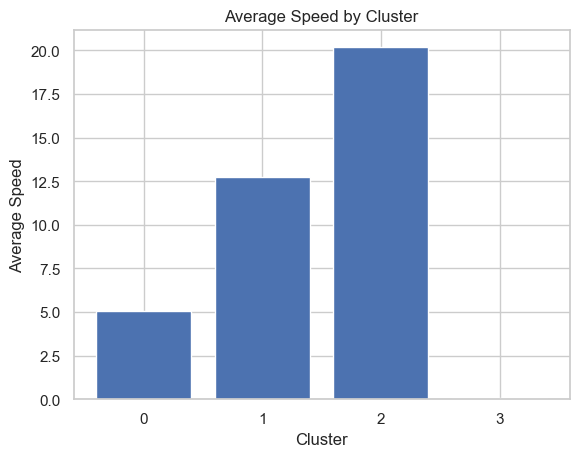

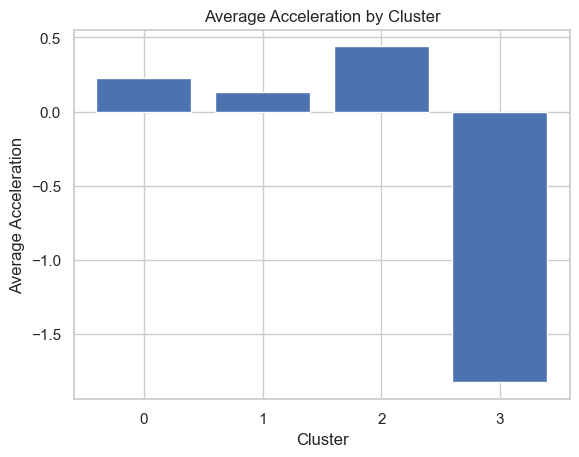

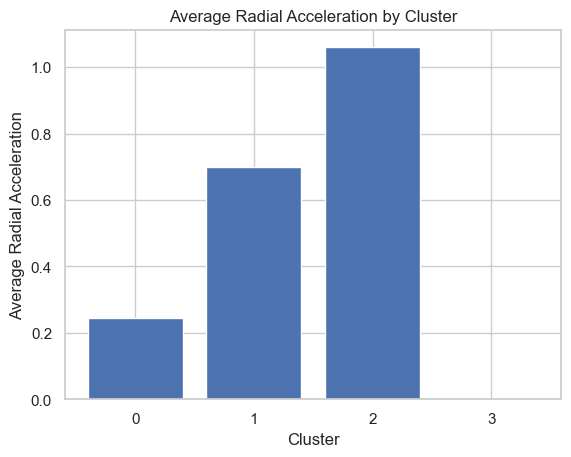

In [112]:
import matplotlib.pyplot as plt


# Calculate average values for each cluster
stat_vals = data_with_clusters.groupby('cluster').mean()

# stat_vals= cluster_data.groupby('TScluster').apply(lambda x: stats.mode(x)[0][0]).reset_index()

# stat_vals = cluster_data.groupby('TScluster').max().reset_index()



# Plot bar graph for Average Speed
plt.bar(stat_vals.index, stat_vals['speed'])
plt.xlabel('Cluster')
plt.ylabel('Average Speed')
plt.title('Average Speed by Cluster')
plt.xticks(stat_vals.index)
plt.show()

# Plot bar graph for Average Acceleration
plt.bar(stat_vals.index, stat_vals['acceleration'])
plt.xlabel('Cluster')
plt.ylabel('Average Acceleration')
plt.title('Average Acceleration by Cluster')
plt.xticks(stat_vals.index)
plt.show()

# Plot bar graph for Average Radial Acceleration
plt.bar(stat_vals.index, stat_vals['radial_acceleration'])
plt.xlabel('Cluster')
plt.ylabel('Average Radial Acceleration')
plt.title('Average Radial Acceleration by Cluster')
plt.xticks(stat_vals.index)
plt.show()

In [113]:
data_with_clusters

,speed,acceleration,radial_acceleration,acceleration_der,cluster,deviceid,trip_id
0,10.25920,-0.251980,1.278067,-0.038397,1,116,2.0
1,7.55940,-0.179987,0.722300,0.004800,0,116,2.0
2,3.77970,-0.251980,0.048332,-0.004800,0,116,2.0
3,9.17927,0.359971,1.052222,0.040797,1,116,2.0
4,8.63931,-0.035997,0.639311,-0.026398,0,116,2.0
...,...,...,...,...,...,...,...
624811,2.15983,-0.057853,0.017268,-0.014922,3,262,5587.0
624812,2.15983,0.000000,0.050073,0.001653,3,262,5587.0
624813,2.69978,0.539950,0.056444,0.539950,0,262,5587.0
624814,5.39957,0.674947,0.062833,0.033749,0,262,5587.0


In [114]:
cluster_data

,trip_id,deviceid,speed,acceleration,radial_acceleration,distance_from_start,TScluster,NormCluster
0,2.0,116,10.25920,-0.251980,1.278067,123.738485,1.0,1
1,2.0,116,7.55940,-0.179987,0.722300,163.044397,1.0,1
2,2.0,116,3.77970,-0.251980,0.048332,211.472339,1.0,1
3,2.0,116,9.17927,0.359971,1.052222,287.492821,1.0,1
4,2.0,116,8.63931,-0.035997,0.639311,343.141212,1.0,1
...,...,...,...,...,...,...,...,...
624424,5583.0,262,0.00000,-1.259900,0.000000,588.723573,0.0,0
624425,5583.0,262,2.69978,2.699780,0.676495,592.632379,0.0,0
624426,5583.0,262,0.00000,-0.899927,0.000000,595.281264,0.0,0
624427,5583.0,262,1.07991,0.037238,0.000068,604.677749,0.0,0


<Figure size 1000x600 with 0 Axes>

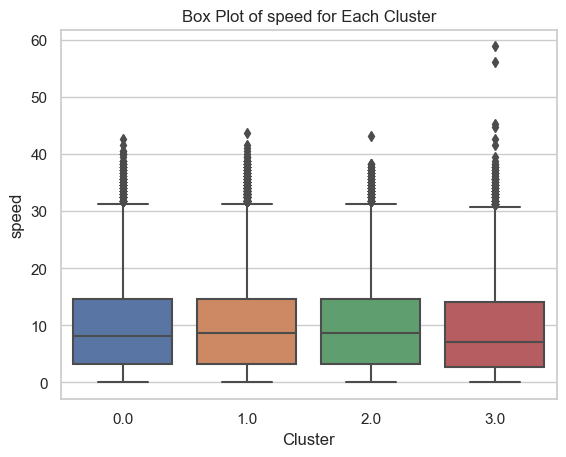

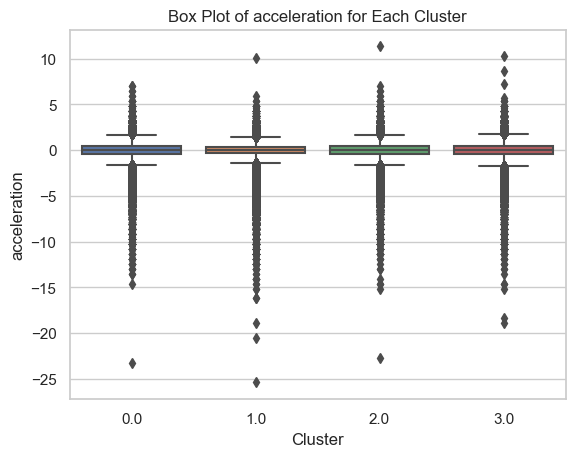

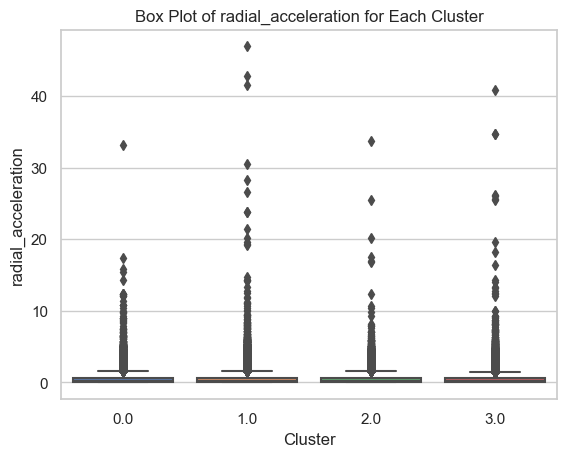

In [115]:
import seaborn as sns
import matplotlib.pyplot as plt

# Assuming your DataFrame is named cluster_data
sns.set(style="whitegrid")
plt.figure(figsize=(10, 6))

# List of features to create box plots for
features = ['speed', 'acceleration', 'radial_acceleration']

for feature in features:
    plt.figure()
    sns.boxplot(x='TScluster', y=feature, data=cluster_data)
    plt.title(f'Box Plot of {feature} for Each Cluster')
    plt.xlabel('Cluster')
    plt.ylabel(feature)
    plt.show()


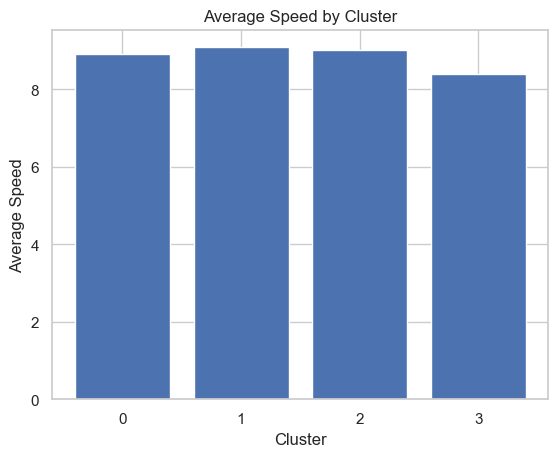

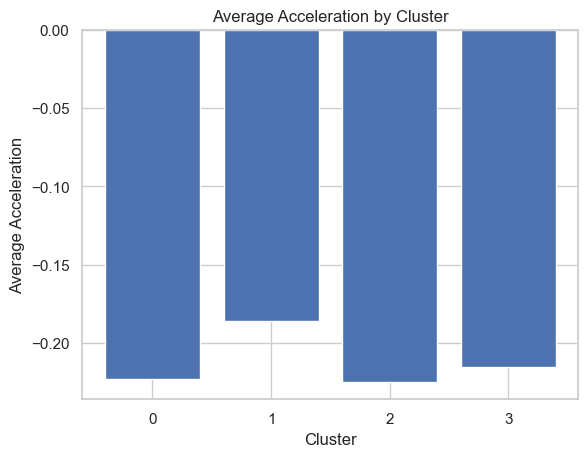

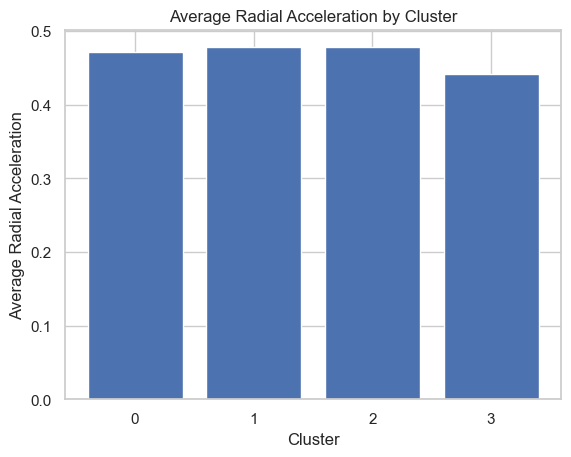

In [116]:
import matplotlib.pyplot as plt


# Calculate average values for each cluster
average_values = TSclusgrped

# Plot bar graph for Average Speed
plt.bar(average_values.index, average_values['speed'])
plt.xlabel('Cluster')
plt.ylabel('Average Speed')
plt.title('Average Speed by Cluster')
plt.xticks(average_values.index)
plt.show()

# Plot bar graph for Average Acceleration
plt.bar(average_values.index, average_values['acceleration'])
plt.xlabel('Cluster')
plt.ylabel('Average Acceleration')
plt.title('Average Acceleration by Cluster')
plt.xticks(average_values.index)
plt.show()

# Plot bar graph for Average Radial Acceleration
plt.bar(average_values.index, average_values['radial_acceleration'])
plt.xlabel('Cluster')
plt.ylabel('Average Radial Acceleration')
plt.title('Average Radial Acceleration by Cluster')
plt.xticks(average_values.index)
plt.show()

### assign cluster values to bus ids

In [117]:
cluster_data

,trip_id,deviceid,speed,acceleration,radial_acceleration,distance_from_start,TScluster,NormCluster
0,2.0,116,10.25920,-0.251980,1.278067,123.738485,1.0,1
1,2.0,116,7.55940,-0.179987,0.722300,163.044397,1.0,1
2,2.0,116,3.77970,-0.251980,0.048332,211.472339,1.0,1
3,2.0,116,9.17927,0.359971,1.052222,287.492821,1.0,1
4,2.0,116,8.63931,-0.035997,0.639311,343.141212,1.0,1
...,...,...,...,...,...,...,...,...
624424,5583.0,262,0.00000,-1.259900,0.000000,588.723573,0.0,0
624425,5583.0,262,2.69978,2.699780,0.676495,592.632379,0.0,0
624426,5583.0,262,0.00000,-0.899927,0.000000,595.281264,0.0,0
624427,5583.0,262,1.07991,0.037238,0.000068,604.677749,0.0,0


In [118]:
import pandas as pd

# Assuming your DataFrame is named df
# Group by 'deviceid' and 'TScluster', count occurrences
grouped = cluster_data.groupby(['deviceid', 'TScluster']).size().reset_index(name='count')

# Pivot the data to create a new DataFrame with clusters as columns
pivot_df = grouped.pivot(index='deviceid', columns='TScluster', values='count').fillna(0)

# Calculate the total counts for each bus ID
pivot_df['total'] = pivot_df.sum(axis=1)

# Calculate the percentage of times each cluster was assigned for each bus ID
for cluster in pivot_df.columns[:-1]:
    pivot_df[cluster] = pivot_df[cluster] / pivot_df['total'] * 100

# Reset the index and rename columns
pivot_df.reset_index(inplace=True)
pivot_df.columns.name = None

pivot_df = pivot_df[['deviceid', 0, 1, 2,3]]

# rename cluster culumns
pivot_df.rename(columns={0: 'TSCluster 0', 1: 'TSCluster 1', 2: 'TSCluster 2', 3: 'TSCluster 3'}, inplace=True)

pivot_df


,deviceid,TSCluster 0,TSCluster 1,TSCluster 2,TSCluster 3
0,116,1.399845,97.647852,0.952303,0.000000
1,117,16.767454,36.851321,12.619731,33.761495
2,121,25.715045,42.999384,16.571408,14.714163
3,123,19.090725,42.906754,17.602003,20.400518
4,128,17.443305,44.655918,15.497493,22.403284
5,209,0.000000,22.404372,26.338798,51.256831
6,250,22.798246,33.162281,17.827485,26.211988
7,262,28.047135,27.471072,21.959113,22.522680


In [119]:
# save csv file
pivot_df.to_csv('../DataOut/bus_trip_TSclusters.csv', index=False)

In [120]:
import pandas as pd

# Assuming your DataFrame is named df
# Group by 'deviceid' and 'NormCluster', count occurrences
grouped = cluster_data.groupby(['deviceid', 'NormCluster']).size().reset_index(name='count')

# Pivot the data to create a new DataFrame with clusters as columns
pivot_df2 = grouped.pivot(index='deviceid', columns='NormCluster', values='count').fillna(0)

# Calculate the total counts for each bus ID
pivot_df2['total'] = pivot_df2.sum(axis=1)

# Calculate the percentage of times each cluster was assigned for each bus ID
for cluster in pivot_df2.columns[:-1]:
    pivot_df2[cluster] = pivot_df2[cluster] / pivot_df2['total'] * 100

# Reset the index and rename columns
pivot_df2.reset_index(inplace=True)
pivot_df2.columns.name = None

pivot_df2 = pivot_df2[['deviceid', 0, 1, 2,3]]

# rename cluster culumns
pivot_df2.rename(columns={0: 'NormCluster 0', 1: 'NormCluster 1', 2: 'NormCluster 2', 3: 'NormCluster 3'}, inplace=True)

pivot_df2


,deviceid,NormCluster 0,NormCluster 1,NormCluster 2,NormCluster 3
0,116,4.269015,84.313565,3.903217,7.514203
1,117,48.311631,51.688369,0.000000,0.000000
2,121,47.975398,45.883732,5.583818,0.557053
3,123,65.348647,28.002785,6.648568,0.000000
4,128,64.264686,31.689590,3.789273,0.256452
5,209,77.595628,22.404372,0.000000,0.000000
6,250,56.267544,41.191520,2.540936,0.000000
7,262,58.964587,39.314723,1.412041,0.308650


In [121]:
# save csv file
pivot_df2.to_csv('../DataOut/bus_trip_NormCluster.csv', index=False)

## Visulaise bus running on map

In [122]:
!pip install folium ipywidgets pandas



[notice] A new release of pip available: 22.3.1 -> 23.2.1
[notice] To update, run: python.exe -m pip install --upgrade pip


In [123]:
pip install ipywidgets



[notice] A new release of pip available: 22.3.1 -> 23.2.1
[notice] To update, run: python.exe -m pip install --upgrade pip


In [124]:
import folium
import pandas as pd
from ipywidgets import interact, IntSlider



# Convert timestamp column to datetime format
data['devicetime'] = pd.to_datetime(data['devicetime'])


In [125]:
data['devicetime'].min()

Timestamp('2021-10-01 06:40:19')

In [126]:
from geopy.geocoders import Nominatim

# Create a geolocator object
geolocator = Nominatim(user_agent="my_geocoder")

# Get the location coordinates (latitude, longitude) for Kandy
Nattarampota_location = geolocator.geocode("Nattarampota, Sri Lanka")
Nattarampota_latitude = Nattarampota_location.latitude
Nattarampota_longitude = Nattarampota_location.longitude

print("Latitude:", Nattarampota_latitude, "Longitude:", Nattarampota_longitude)
Nattarampota_location = [Nattarampota_latitude, Nattarampota_longitude]  # Kandy city location

GeocoderUnavailable: HTTPSConnectionPool(host='nominatim.openstreetmap.org', port=443): Max retries exceeded with url: /search?q=Nattarampota%2C+Sri+Lanka&format=json&limit=1 (Caused by NameResolutionError("<urllib3.connection.HTTPSConnection object at 0x000001D2A3B64D90>: Failed to resolve 'nominatim.openstreetmap.org' ([Errno 11001] getaddrinfo failed)"))

In [ ]:
# from geopy.geocoders import Nominatim

# # Create a geolocator object
# geolocator = Nominatim(user_agent="my_geocoder")

# # Get the location coordinates (latitude, longitude) for Kandy
# kandy_location = geolocator.geocode("Kandy, Sri Lanka")
# kandy_latitude = kandy_location.latitude
# kandy_longitude = kandy_location.longitude

# print("Latitude:", kandy_latitude, "Longitude:", kandy_longitude)
# Kandy_location = [kandy_latitude, kandy_longitude]  # Kandy city location

In [ ]:
from geopy.geocoders import Nominatim

# Create a geolocator object
geolocator = Nominatim(user_agent="my_geocoder")

# Get the location coordinates (latitude, longitude) for digana
digana_location = geolocator.geocode("Digana, Sri Lanka")
digana_latitude = digana_location.latitude
digana_longitude = digana_location.longitude

print("Latitude:", digana_latitude, "Longitude:", digana_longitude)
digana_location = [digana_latitude, digana_longitude]  # Kandy city location

In [ ]:
data.head(20)

,id,deviceid,devicetime,latitude,longitude,speed,date,time,geometry,bus_stop,trip_id,direction,acceleration,radial_acceleration,distance_from_start,time_diff,acc_diff,acceleration_der,devicetime_seconds
0,574733100,116,2021-10-16 08:03:34,7.293043,80.637552,10.25920,2021-10-16,08:03:34,POINT (184964.84865244984 232317.35306792473),NaN,2.0,1,-0.251980,1.278067,123.738485,0 days 00:00:15,-0.575955,-0.038397,1300995.0
1,574733101,116,2021-10-16 08:03:49,7.292725,80.637707,7.55940,2021-10-16,08:03:49,POINT (184981.95255171193 232282.14959255166),NaN,2.0,1,-0.179987,0.722300,163.044397,0 days 00:00:15,0.071993,0.004800,1301010.0
2,574733102,116,2021-10-16 08:04:04,7.292292,80.637663,3.77970,2021-10-16,08:04:04,POINT (184977.15733984314 232234.22458233108),NaN,2.0,1,-0.251980,0.048332,211.472339,0 days 00:00:15,-0.071993,-0.004800,1301025.0
3,574736662,116,2021-10-16 08:04:19,7.291640,80.637455,9.17927,2021-10-16,08:04:19,POINT (184954.1363920236 232162.16484193364),101,2.0,1,0.359971,1.052222,287.492821,0 days 00:00:15,0.611951,0.040797,1301040.0
4,574736663,116,2021-10-16 08:04:34,7.291210,80.637713,8.63931,2021-10-16,08:04:34,POINT (184982.64260533327 232114.61697960715),101,2.0,1,-0.035997,0.639311,343.141212,0 days 00:00:15,-0.395969,-0.026398,1301055.0
5,574736664,116,2021-10-16 08:04:49,7.290943,80.638160,0.00000,2021-10-16,08:04:49,POINT (185031.9565310351 232085.11003064158),101,2.0,1,-0.575954,0.000000,400.646939,0 days 00:00:15,-0.539957,-0.035997,1301070.0
6,574736665,116,2021-10-16 08:05:04,7.290943,80.638157,0.00000,2021-10-16,08:05:04,POINT (185031.58111776915 232085.11014168937),101,2.0,1,0.000000,0.000000,401.021945,0 days 00:00:15,0.575954,0.038397,1301085.0
7,574736666,116,2021-10-16 08:05:19,7.290943,80.638157,0.00000,2021-10-16,08:05:19,POINT (185031.58111776915 232085.11014168937),101,2.0,1,0.000000,0.000000,401.021945,0 days 00:00:15,0.000000,0.000000,1301100.0
8,574736667,116,2021-10-16 08:05:34,7.290752,80.638305,6.47948,2021-10-16,08:05:34,POINT (185047.9605390529 232063.90664561786),101,2.0,1,0.431965,0.333808,427.897272,0 days 00:00:15,0.431965,0.028798,1301115.0
9,574736668,116,2021-10-16 08:05:49,7.290443,80.638827,9.17927,2021-10-16,08:05:49,POINT (185105.5433407406 232029.79709995503),NaN,2.0,1,0.179986,0.546434,494.867094,0 days 00:00:15,-0.251979,-0.016799,1301130.0


In [ ]:
import folium
import pandas as pd
from shapely.geometry import Point
from ipywidgets import FloatSlider, interact, Label, Output, VBox, Button, HBox

# Assuming you have 'data' DataFrame containing bus data

# Dictionary to store last known location of each bus
bus_locations = {}

# Create Point geometries for Kandy and Digana
kandy_location = Point(kandy_latitude, kandy_longitude)
digana_location = Point(digana_latitude, digana_longitude)  # Define the coordinates for Digana

def create_map():
    return folium.Map(location=Nattarampota_location, zoom_start=14)

def update_map(timestamp):
    m = create_map()  # Create a new map instance each time
    interval = pd.Timedelta(seconds=15)
    timestamp_dt = pd.Timestamp.fromtimestamp(timestamp)  # Convert timestamp to pandas Timestamp
    interval_start = timestamp_dt - interval / 2
    interval_end = timestamp_dt + interval / 2

    bus_data_within_interval = data[(data['devicetime'] >= interval_start) & (data['devicetime'] <= interval_end)]
    bus_data_within_interval = bus_data_within_interval.sort_values(by='devicetime', ascending=False)
    unique_buses = data['deviceid'].unique()

    for deviceid in unique_buses:
        latest_data_for_bus = None  # Initialize the variable here

        bus_data_for_bus = bus_data_within_interval[bus_data_within_interval['deviceid'] == deviceid]
        if len(bus_data_for_bus) > 0:
            latest_data_for_bus = bus_data_for_bus.iloc[0]
            bus_location = [latest_data_for_bus['latitude'], latest_data_for_bus['longitude']]
            bus_locations[deviceid] = bus_location
        else:
            bus_location = bus_locations.get(deviceid)

        if bus_location is not None:
            bus_point = Point(bus_location[0], bus_location[1])

            # Adjust the color using a consistent formula
            color = "#{:06x}".format(deviceid + 100000)

            # get speed acceleration and radial acceleration into three variables
            if latest_data_for_bus is not None:
                speed = latest_data_for_bus['speed']
                acceleration = latest_data_for_bus['acceleration']
                radial_acceleration = latest_data_for_bus['radial_acceleration']
                print(speed, acceleration, radial_acceleration)
            else:
                speed = 0
                acceleration = 0
                radial_acceleration = 0

            folium.Marker(
                location=bus_location,
                popup=[deviceid, speed, acceleration, radial_acceleration],
                color=color  # Use the calculated color
            ).add_to(m)

    return m

min_timestamp = data['devicetime'].min()
max_timestamp = data['devicetime'].max()

# Calculate step size in seconds
step_size_seconds = 15
slider = FloatSlider(value=min_timestamp.timestamp(), min=min_timestamp.timestamp(), max=max_timestamp.timestamp(), step=step_size_seconds)

# Adjust the length of the slider using CSS style
slider.style.handle_length = '500px'  # Adjust the length as desired

time_label = Label(value=pd.Timestamp.fromtimestamp(slider.value).strftime('%Y-%m-%d %H:%M:%S'))

def update_time_label(change):
    time_label.value = pd.Timestamp.fromtimestamp(change['new']).strftime('%Y-%m-%d %H:%M:%S')

slider.observe(update_time_label, 'value')

stop = False  # Declare stop as a global variable

# Button to stop continuous play
def stop_continuous(_):
    global stop
    stop = True
    
# Button to move slider left
def move_left(_):
    slider.value -= step_size_seconds

# Button to move slider right
def move_right(_):
    slider.value += step_size_seconds

# Button to move slider left continuously
def move_left_continuous(_):
    while slider.value > slider.min and not stop:
        slider.value -= step_size_seconds

# Button to move slider right continuously
def move_right_continuous(_):
    while slider.value < slider.max and not stop:
        slider.value += step_size_seconds





left_button = Button(description='<<', icon='angle-left')
right_button = Button(description='>>', icon='angle-right')
left_continuous_button = Button(description='Continuous <<', icon='step-backward')
right_continuous_button = Button(description='Continuous >>', icon='step-forward')
stop_button = Button(description='Stop', icon='stop')

left_button.on_click(move_left)
right_button.on_click(move_right)
left_continuous_button.on_click(move_left_continuous)
right_continuous_button.on_click(move_right_continuous)
stop_button.on_click(stop_continuous)

buttons_row = HBox([left_button, left_continuous_button, right_button, right_continuous_button, stop_button])
controls_box = VBox([buttons_row, slider, time_label])

out_map = Output()
out_map.layout.height = '1000px'  # Adjust the height as desired

def update_map_output(change):
    with out_map:
        out_map.clear_output(wait=True)
        display(update_map(slider.value))

slider.observe(update_map_output, 'value')

app_layout = VBox([controls_box, out_map])

display(app_layout)


NameError: name 'kandy_latitude' is not defined

In [ ]:
# Anomaly trips detected and removed: [166.0, 193.0, 195.0, 207.0, 235.0, 1081.0, 1105.0, 141.0, 147.0, 153.0, 155.0, 157.0, 160.0, 171.0, 177.0, 190.0, 194.0, 206.0, 210.0, 226.0, 879.0]

In [ ]:
import folium
from shapely.geometry import Point
import pandas as pd
from geopy.geocoders import Nominatim

# Get the location coordinates (latitude, longitude) for Kandy
kandy_location = geolocator.geocode("Kandy, Sri Lanka")
kandy_latitude = kandy_location.latitude
kandy_longitude = kandy_location.longitude

# Function to create the map
def create_map():
    return folium.Map(location=[kandy_latitude, kandy_longitude], zoom_start=14)

# Function to plot a specific trip on the map
def plot_trip_on_map(trip_id):
    m = create_map()  # Create a new map instance each time
    
    trip_data = data[data['trip_id'] == trip_id]
    trip_data = trip_data.sort_values(by='devicetime')
    
    for index, row in trip_data.iterrows():
        bus_location = [row['latitude'], row['longitude']]
        bus_point = Point(bus_location[0], bus_location[1])
        color = "#{:06x}".format(int(trip_id) + 100000)  # Adjust the color using a consistent formula
        
        # Add a marker for each point in the trip data
        folium.Marker(
            location=bus_location,
            color=color,
            # popup=f"Trip ID: {trip_id}<br>Speed: {row['speed']}<br>Acceleration: {row['acceleration']}<br>Radial Acceleration: {row['radial_acceleration']}"
        ).add_to(m)
    
    return m

# Replace 'your_trip_id_here' with the actual trip ID you want to visualize
trip_id_to_visualize = 193

map_for_trip = plot_trip_on_map(trip_id_to_visualize)
display(map_for_trip)


In [ ]:
data[data['trip_id'] == 1364]